<a href="https://github.com/RaymondWKWong/Seeing-the-Unseen/blob/main/Reconstruction/Reconstruction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open in Colab"/></a>

In [ ]:
pip install -U keras-tuner

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import numpy as np
import tensorflow as tf
import tensorflow_datasets as tfds
import os
import tempfile
import cv2
import glob
from sklearn.naive_bayes import GaussianNB
tmpdir = tempfile.mkdtemp()
from tensorflow import keras
tfds.disable_progress_bar()
from tensorflow.keras import layers
#from tensorflow.keras.preprocessing.image import ImageDataGenerator

from tensorflow.keras.layers import Dense, Conv1D, Conv2D, Activation, Flatten, MaxPooling2D, Dropout, LeakyReLU, MaxPooling1D
from kerastuner.tuners import RandomSearch
from kerastuner.engine.hyperparameters import HyperParameters
from skimage import io
from keras.models import load_model
from keras.preprocessing import image

from tqdm import tqdm
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, roc_auc_score

from sklearn.multiclass import OneVsRestClassifier
from skimage import data, img_as_float
from skimage.metrics import structural_similarity as ssim
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn import svm, datasets
from sklearn.metrics import roc_curve, auc
from itertools import cycle
import datetime
from tensorflow.keras.callbacks import TensorBoard
from skimage.util import random_noise
from sklearn import preprocessing
from scipy.io import loadmat
import tensorflow.keras as tfk
from tensorflow.keras.models import Sequential
from tensorflow.keras.optimizers import Adam
import time
import pylab as pl
from IPython import display
import math
import statistics

# Data Preperation

In [3]:
batch_size = 64
img_height = 256
img_width = 256
img_size = 256

In [ ]:
input_2trans_mat = loadmat('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Data/input_2trans_2seed.mat')
input_2trans = input_2trans_mat['input'] # 2 transducer elements on each edge

output_2trans_mat = loadmat('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Data/output_2trans_2seed.mat')
output_2trans = output_2trans_mat['output'] # 2 transducer elements on each edge
output_2trans = np.rollaxis(output_2trans, 2, 0) # rearranging data for processing

In [ ]:
input_2trans_mat = loadmat('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Data/input_2trans_5seed.mat')
input_2trans = input_2trans_mat['input'] # 2 transducer elements on each edge

output_2trans_mat = loadmat('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Data/output_2trans_5seed.mat')
output_2trans = output_2trans_mat['output'] # 2 transducer elements on each edge
output_2trans = np.rollaxis(output_2trans, 2, 0) # rearranging data for processing

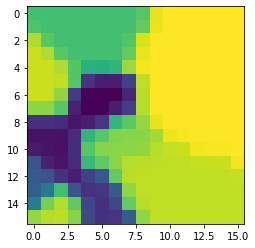

In [ ]:
plt.imshow(output_2trans[0,:,:])

In [ ]:
input_2trans.shape

(2500, 24)

In [ ]:
output_2trans.shape

(2500, 256)

In [11]:
# reshape images into 1D 

# FOR DENSE MODEL
# size = len(output_2trans[0,0,:])
# output_2trans = np.reshape(output_2trans,(size,256))

size = len(output_2trans[:,0,0])
output_2trans = np.reshape(output_2trans,(size,img_size))

input_2trans = preprocessing.scale(input_2trans) # standardising - check notes
output_2trans = preprocessing.scale(output_2trans) # standardising - check notes

input_2trans_test = input_2trans[3750:5000,:]
output_2trans_test = output_2trans[3750:5000,:]

input_2trans = np.delete(input_2trans,(np.arange(6250)+3750),axis=0)
output_2trans = np.delete(output_2trans,(np.arange(6250)+3750),axis=0)

x_train_2trans, x_test_2trans, y_train_2trans, y_test_2trans = train_test_split(input_2trans, output_2trans, test_size=0.01)

x_train_2trans = np.expand_dims(x_train_2trans, axis=-1) # Adding column for processing with conv
x_test_2trans = np.expand_dims(x_test_2trans, axis=-1) # Adding column for processing with conv

y_train_2trans = np.expand_dims(y_train_2trans, axis=-1) # TEST
y_test_2trans = np.expand_dims(y_test_2trans, axis=-1) # TEST

In [ ]:
# reshape images into 1D for 7500 data

# FOR DENSE MODEL
# size = len(output_2trans[0,0,:])
# output_2trans = np.reshape(output_2trans,(size,256))

size = len(output_2trans[:,0,0])
output_2trans = np.reshape(output_2trans,(size,img_size))

input_2trans = preprocessing.scale(input_2trans) # standardising - check notes
output_2trans = preprocessing.scale(output_2trans) # standardising - check notes

input_2trans_test = input_2trans[5625:7500,:]
output_2trans_test = output_2trans[5625:7500,:]

input_2trans = np.delete(input_2trans,(np.arange(4375)+5625),axis=0)
output_2trans = np.delete(output_2trans,(np.arange(4375)+5625),axis=0)

x_train_2trans, x_test_2trans, y_train_2trans, y_test_2trans = train_test_split(input_2trans, output_2trans, test_size=0.01)

x_train_2trans = np.expand_dims(x_train_2trans, axis=-1) # Adding column for processing with conv
x_test_2trans = np.expand_dims(x_test_2trans, axis=-1) # Adding column for processing with conv

y_train_2trans = np.expand_dims(y_train_2trans, axis=-1) # TEST
y_test_2trans = np.expand_dims(y_test_2trans, axis=-1) # TEST

In [12]:
input_shape = x_train_2trans.shape
input_shape

(3712, 24, 1)

# Hyperparameter Tuning

In [ ]:
!rm -rf /logs/
%load_ext tensorboard
log_folder = 'logs'
log_folder = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

In [ ]:
# FOR TUNING

for i in tqdm(range(0,256)):

  def build_model(hp):
    model = keras.models.Sequential()

    model.add(Conv1D(input_shape = input_shape[1:], kernel_size=hp.Int("kernel_size", min_value=2, max_value=5, step=1), filters=hp.Int("filters", min_value=2, max_value=12, step=2)))
    model.add(Activation('LeakyReLU'))
    # model.add(MaxPooling1D(pool_size=2,strides=1))

    for i in range(hp.Int("number_layers", 3, 5, 1)):
      model.add(Conv1D(input_shape = input_shape[1:], kernel_size=hp.Int("kernel_size", min_value=2, max_value=5, step=1), filters=hp.Int("filters", min_value=2, max_value=12, step=2)))
      model.add(Activation('LeakyReLU'))
      # model.add(MaxPooling1D(pool_size=2,strides=1))
      model.add(Dropout(0.2))

    # model.add(Flatten())  # this converts our 3D feature maps to 1D feature vectors

    model.add(Dense(1))
    # model.add(Activation("softmax"))

    hp_learning_rate = hp.Choice('learning_rate', values=[1e-4, 1.5e-4, 2e-4, 2.5e-4, 3e-4, 3.5e-4, 4e-4, 4.5e-4, 5e-4, 5.5e-4, 6e-4, 6.5e-4, 7e-4, 7.5e-4, 8e-4, 8.5e-4, 9e-4, 9.5e-4, 1e-3])

    model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=hp_learning_rate),
                  loss="mae",
                  metrics=["accuracy"])
      
    return model

  tuner = RandomSearch(
        build_model,
        objective='val_accuracy',
        max_trials=30, # WAS 10 
        executions_per_trial=20 # WAS 10
  )

  tensorboard_callback =  [TensorBoard(log_dir=log_folder,
                                      write_graph=True,
                                      write_images=True,
                                      update_freq='epoch',
                                      profile_batch=2,
                                      embeddings_freq=1)]

  tuner.search(x = x_train_2trans, y=y_train_2trans[:,i], epochs=64, batch_size=batch_size, validation_split=0.2, callbacks=[tensorboard_callback]) # EPOCH WAS 10

Trial 15 Complete [00h 05m 40s]
val_accuracy: 0.0

Best val_accuracy So Far: 0.0
Total elapsed time: 01h 37m 29s

Search: Running Trial #16

Hyperparameter    |Value             |Best Value So Far 
kernel_size       |4                 |4                 
filters           |10                |4                 
number_layers     |4                 |4                 
learning_rate     |0.00065           |0.0004            

Epoch 1/64
93/93 [==============================] - 2s 13ms/step - loss: 0.8678 - accuracy: 0.0000e+00 - val_loss: 0.8708 - val_accuracy: 0.0000e+00
Epoch 2/64
93/93 [==============================] - 0s 5ms/step - loss: 0.8598 - accuracy: 0.0000e+00 - val_loss: 0.8651 - val_accuracy: 0.0000e+00
Epoch 3/64
93/93 [==============================] - 0s 5ms/step - loss: 0.8527 - accuracy: 0.0000e+00 - val_loss: 0.8571 - val_accuracy: 0.0000e+00
Epoch 4/64
93/93 [==============================] - 0s 5ms/step - loss: 0.8448 - accuracy: 0.0000e+00 - val_loss: 0.8467 - val_a

  0%|          | 0/256 [1:39:06<?, ?it/s]


KeyboardInterrupt: ignored

In [ ]:
# Hyperparameter tuning graphs for 2 seed 2 trans

%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
# Hyperparameter tuning graphs for 2 seed 5 trans

%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
  # Top 10 best model's summary

print(tuner.results_summary())

Results summary
Results in ./untitled_project
Showing 10 best trials
Objective(name='val_accuracy', direction='max')
Trial summary
Hyperparameters:
kernel_size: 4
filters: 12
number_layers: 4
learning_rate: 0.0002
Score: 0.0
Trial summary
Hyperparameters:
kernel_size: 3
filters: 10
number_layers: 4
learning_rate: 0.00065
Score: 0.0
Trial summary
Hyperparameters:
kernel_size: 4
filters: 10
number_layers: 3
learning_rate: 0.0005
Score: 0.0
Trial summary
Hyperparameters:
kernel_size: 4
filters: 4
number_layers: 4
learning_rate: 0.00055
Score: 0.0
Trial summary
Hyperparameters:
kernel_size: 3
filters: 10
number_layers: 3
learning_rate: 0.0007
Score: 0.0
Trial summary
Hyperparameters:
kernel_size: 2
filters: 4
number_layers: 3
learning_rate: 0.00075
Score: 0.0
None


# Train Model

In [ ]:
!rm -rf /logs/
%load_ext tensorboard
log_folder = 'logs'
log_folder = "logs/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

In [ ]:
# Original Model

netParams = [0.0037, 5, 'LeakyReLU', 64,0.006, 12, 2] 

callbacks = [TensorBoard(log_dir=log_folder)]


def create_model(outCellInd,learning_rate, num_conv_layers,
                activation, batch_size, adam_decay, filters, kernel_size):
    #start the model making process and create our first layer
    model = Sequential()
    model.add(Conv1D(filters=filters, input_shape= input_shape[1:], kernel_size=(kernel_size), activation=activation
                  ))
    #create a loop making a new conv layer for the amount passed to this model.
    #naming the layers helps avoid tensorflow error deep in the stack trace.
    for i in range(num_conv_layers):
        name = 'layer_conv_{0}'.format(i+1)
        model.add(Conv1D(filters=filters, input_shape= input_shape[1:], kernel_size=(kernel_size),
                        activation=activation,
                        name=name
                ))
        model.add(MaxPooling1D(pool_size=2,strides=1))
        model.add(Dropout(0.2))
    #add our classification layer.
    model.add(Dense(1))
    
    #setup our optimizer and compile
    adam = Adam(lr=learning_rate, decay= adam_decay)
    model.compile(optimizer=adam, loss='mse', metrics=["accuracy"])
    
    history=model.fit(x=x_train_2trans,
                    y=y_train_2trans[:,outCellInd],
                    epochs=500,
                    callbacks=callbacks,
                    verbose=0,
                    batch_size=batch_size,
                    validation_split=0.2
                    )
    return model,history

In [ ]:
# 2 Trans 2 Seed Model

netParams = [0.0005, 5, 'LeakyReLU', 64,0.006, 10, 4]

callbacks = [TensorBoard(log_dir=log_folder)]


def create_model(outCellInd,learning_rate, num_conv_layers,
                activation, batch_size, adam_decay, filters, kernel_size):
    #start the model making process and create our first layer
    model = Sequential()
    model.add(Conv1D(filters=filters, input_shape= input_shape[1:], kernel_size=(kernel_size), activation=activation
                  ))
    #create a loop making a new conv layer for the amount passed to this model.
    #naming the layers helps avoid tensorflow error deep in the stack trace.
    for i in range(num_conv_layers):
        name = 'layer_conv_{0}'.format(i+1)
        model.add(Conv1D(filters=filters, input_shape= input_shape[1:], kernel_size=(kernel_size),
                        activation=activation,
                        name=name
                ))
        model.add(MaxPooling1D(pool_size=2,strides=1))
        model.add(Dropout(0.2))
    #add our classification layer.
    model.add(Dense(1))
    
    #setup our optimizer and compile
    adam = Adam(lr=learning_rate, decay= adam_decay)
    model.compile(optimizer=adam, loss='mse', metrics=["accuracy"])
    
    history=model.fit(x=x_train_2trans,
                    y=y_train_2trans[:,outCellInd],
                    epochs=500,
                    callbacks=callbacks,
                    verbose=0,
                    batch_size=batch_size,
                    validation_split=0.2
                    )
    return model,history

In [ ]:
# 2 Trans 5 Seed Model

netParams = [0.00045, 5, 'LeakyReLU', 64,0.006, 10, 4]

callbacks = [TensorBoard(log_dir=log_folder)]


def create_model(outCellInd,learning_rate, num_conv_layers,
                activation, batch_size, adam_decay, filters, kernel_size):
    #start the model making process and create our first layer
    model = Sequential()
    model.add(Conv1D(filters=filters, input_shape= input_shape[1:], kernel_size=(kernel_size), activation=activation
                  ))
    #create a loop making a new conv layer for the amount passed to this model.
    #naming the layers helps avoid tensorflow error deep in the stack trace.
    for i in range(num_conv_layers):
        name = 'layer_conv_{0}'.format(i+1)
        model.add(Conv1D(filters=filters, input_shape= input_shape[1:], kernel_size=(kernel_size),
                        activation=activation,
                        name=name
                ))
        model.add(MaxPooling1D(pool_size=2,strides=1))
        model.add(Dropout(0.2))
    #add our classification layer.
    model.add(Dense(1))
    
    #setup our optimizer and compile
    adam = Adam(lr=learning_rate, decay= adam_decay)
    model.compile(optimizer=adam, loss='mse', metrics=["accuracy"])
    
    history=model.fit(x=x_train_2trans,
                    y=y_train_2trans[:,outCellInd],
                    epochs=500,
                    callbacks=callbacks,
                    verbose=0,
                    batch_size=batch_size,
                    validation_split=0.2
                    )
    return model,history

In [ ]:
#train network for each pixel
trans_2mod =[]

for i in tqdm(range(0,256)):
    modelOut=create_model(i,netParams[0],netParams[1],netParams[2],netParams[3],netParams[4],netParams[5],netParams[6])
    trans_2mod.append(modelOut)

  0%|          | 0/256 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/keras/optimizer_v2/optimizer_v2.py:356: UserWarning: The `lr` argument is deprecated, use `learning_rate` instead.
  "The `lr` argument is deprecated, use `learning_rate` instead.")
100%|██████████| 256/256 [10:36:36<00:00, 149.21s/it]


# Save Load Models

In [ ]:
# Save files

# trans_2mod.save('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2mod_tuned2seed')
# trans_2.save('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_dense')

from google.colab import drive
drive.mount('/content/drive')

# with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_2seed_tuned7500.txt', 'wb') as f:
#     np.save(f, trans_2)

# with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_2seed_train_tuned7500.txt', 'wb') as f:
#     np.save(f, trans_2_train)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [7]:
# Load

# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_conv.txt') # OG code
# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_conv1.txt') # 2nd code with kernel=3
# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_conv2.txt') # 3rd code with kernel=2
# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_conv3.txt') # 4th code with kernel=1
# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_conv4.txt') # 5th code with kernel=2 with learning rate=0.0037 and adam decay=0.006, with max pool
# trans_1 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_conv5.txt') # 6th code with kernel=2 with learning rate=0.0037 and adam decay=0.006, with max pool and dropout, 12 filters
# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_conv6.txt') # 7th code with kernel=2 with learning rate=0.0037 and adam decay=0.006, WITHOUT max pool AND dropout, 12 filters
# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_conv7.txt') # Code with kernel=2 with learning rate=0.0037 and adam decay=0.006, with max pool and dropout, 12 filters & epoch graph
# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_dense.txt') # For DNN

# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_5seed.txt') # LR = 0.0037
# trans_2_train = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_5seed_train.txt') # LR = 0.0037

# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_5seedA.txt') # LR = 0.0001
# trans_2_train = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_5seed_trainA.txt') # LR = 0.0001

# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_2seed.txt') # Optimised Model
# trans_2_train = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_2seed_train.txt') # Optimised Model

# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_5seed.txt') # Optimised Model
# trans_2_train = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_5seed_train.txt') # Optimised Model

# trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_2seed_tuned7500.txt') # 2 Seed Optimised Model 7500 data
# trans_2_train = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_2seed_tuned7500.txt') # 2 Seed Optimised Model 7500 data

trans_2 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_5seed_tuned.txt') # 5 Seed Optimised Model 7500 data
trans_2_train = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/trans_2_5seed_tuned.txt') # 5 Seed Optimised Model 7500 data

# Store Results

In [ ]:
input_2trans_test = np.expand_dims(input_2trans_test, axis=-1) # Reshape for CNN

In [ ]:
# With training data
input_2trans = np.expand_dims(input_2trans, axis=-1) # Reshape for CNN

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_100.txt', 'wb') as f:
#     np.save(f, trans_2_mul_100)

# with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_100.txt', 'wb') as f:
#     np.save(f, trans_2_add_100)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Load noise data

input_2trans_mul = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mul_input_test_100.txt') # Multiplicative noise input data
input_2trans_add = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/add_input_test_100.txt') # Additive noise input data

In [ ]:
# With noise data
input_2trans_mul = np.expand_dims(input_2trans_mul, axis=-1) # Reshape for CNN
input_2trans_add = np.expand_dims(input_2trans_add, axis=-1) # Reshape for CNN

In [ ]:
# Testing with multiplicative noise data
trans_2_mul =[]

for i in range(0,256):
    # full aperture
    recon = trans_2mod[i][0].predict(input_2trans_mul)
    trans_2_mul.append(recon)
    

# convert results to numpy arrays
trans_2_mul_100 = np.array(trans_2_mul)

In [ ]:
# Testing with additive noise data
trans_2_add =[]

for i in range(0,256):
    # full aperture
    recon = trans_2mod[i][0].predict(input_2trans_add)
    trans_2_add.append(recon)
    

# convert results to numpy arrays
trans_2_add_100 = np.array(trans_2_add)

In [ ]:
trans_2 =[]

for i in range(0,256):
    # full aperture
    recon = trans_2mod[i][0].predict(input_2trans_test)
    trans_2.append(recon)
    

# convert results to numpy arrays
trans_2 = np.array(trans_2)

In [ ]:
# Testing with training data
trans_2_train =[]

for i in range(0,256):
    # full aperture
    recon = trans_2mod[i][0].predict(input_2trans)
    trans_2_train.append(recon)
    

# convert results to numpy arrays
trans_2_train = np.array(trans_2_train)

# Evaluation

In [15]:
# Merged image for evaluation

merge_2trans = []
size_i = trans_2.shape[1]
size_n = trans_2.shape[2]

for i in range(size_i):

  xInd = i

  for n in range(size_n):

    merge_2trans.append(np.reshape(trans_2[:,xInd,n,0],[16,16])) # CHANGE TO trans_2_train FOR TRAIN DATA

# Split data to filter sets for each prediction
merge_2trans = np.array_split(merge_2trans, size_i)
merge_2trans = np.array(merge_2trans)
sizeA = merge_2trans.shape[0]
sizeB = merge_2trans.shape[2]
sizeC = merge_2trans.shape[3]
testing = np.zeros((sizeA,sizeB,sizeC))
avg_merge = np.zeros((sizeA,sizeB,sizeC))
pred_mean = np.zeros((sizeA,sizeB,sizeC))
pred_var = np.zeros((sizeA,sizeB,sizeC))
size_j = merge_2trans.shape[2]

for i in range(size_i):

  xInd = i

  for n in range(size_n):
    for j in range(size_j):

      jInd = j

      for k in range(size_j):
        testing[xInd,:,:] =+ merge_2trans[xInd,n,:,:]
        avg_merge[xInd,:,:] = testing[xInd,:,:] / size_n #averaged image

        pred_mean[xInd,jInd,k] = sum(merge_2trans[xInd,:,jInd,k]) / size_n
        pred_var[xInd,jInd,k] = (sum((merge_2trans[xInd,:,jInd,k]) - (pred_mean[xInd,jInd,k])) ** 2) / size_n # calculates variance of all filter outputs
        # pred_var[xInd,jInd,k] = statistics.variance(merge_2trans[xInd,:,jInd,k])

In [16]:
# MSE and SSIM Evaluation

mse_2trans = []
mod_pred_2trans = []
mse_2trans_score = []
ssim_2trans = []
ssim_2trans2 = []
ssim_2trans_score = []
loc_2trans = []
mae_pred = []
mae_avg = []

size_i = trans_2.shape[1]
size_n = trans_2.shape[2]

for i in range(size_i):

  xInd = i
  mod_true = np.reshape(output_2trans_test[xInd,:],[16,16])

  for n in range(size_n):

    mod_pred_2trans.append(np.reshape(trans_2[:,xInd,n,0],[16,16]))

    mse_2trans.append(mean_squared_error(mod_true, mod_pred_2trans[n])) # Compiling list of scores for all predictions and all voronois

    ssim_2trans.append(ssim(mod_true, mod_pred_2trans[n], # Compiling list of scores for all predictions and all voronois
                      data_range=mod_pred_2trans[n].max() - mod_pred_2trans[n].min()))


mse_2trans = np.array_split(mse_2trans, size_i) # Splitting MSE scores into rows for each prediction and columns for each true voronoi
mse_2trans = np.array(mse_2trans)

ssim_2trans = np.array_split(ssim_2trans, size_i) # Splitting SSIM scores into rows for each prediction and columns for each true voronoi
ssim_2trans = np.array(ssim_2trans)


for i in range(size_i):

  mse_2trans_score.append(np.where(mse_2trans[i,:] == np.amin(mse_2trans[i,:]))) # Searches for minimum index of MSE for each prediction
  ssim_2trans_score.append(np.where(ssim_2trans[i,:] == np.amax(ssim_2trans[i,:]))) # Searches for maximum index of SSIM for each prediction

mse_2trans_score = np.array(mse_2trans_score)
mse_2trans_score = mse_2trans_score[:,0,0]
ssim_2trans_score = np.array(ssim_2trans_score)
ssim_2trans_score = ssim_2trans_score[:,0,0]

loc_2trans.append(mse_2trans_score) # Stores MSE locations into first row
loc_2trans.append(ssim_2trans_score) # Stores SSIM locations into second row
loc_2trans2 = np.array(loc_2trans)

for i in range(size_i):

  mod_true = np.reshape(output_2trans_test[i,:],[16,16]) # True voronoi

  mod_pred_2trans = np.reshape(trans_2[:,i, loc_2trans2[0,i] ,0],[16,16]) # Shows most similar prediction
  filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
  mae_pred.append(mean_absolute_error(mod_true, filter_pred))
  ssim_2trans2.append(ssim(mod_true, filter_pred))

  # avg_im = avg_merge[i,:,:]
  # filter_avg = cv2.GaussianBlur(avg_im,(3,3),0) # Gaussian smoothing
  # mae_avg.append(mean_absolute_error(mod_true, filter_avg))

mae_pred = np.array(mae_pred)
mae_avg = np.array(mae_avg)

IndexError: ignored

In [ ]:
# MSE and SSIM Evaluation FOR TRAIN DATA

mse_2trans = []
mod_pred_2trans = []
mse_2trans_score = []
ssim_2trans = []
ssim_2trans_score = []
loc_2trans = []
mae_pred = []
mae_avg = []

size_i = trans_2.shape[1]
size_n = trans_2.shape[2]

for i in range(size_i):

  xInd = i
  mod_true = np.reshape(output_2trans[xInd,:],[16,16])

  for n in range(size_n):

    mod_pred_2trans.append(np.reshape(trans_2_train[:,xInd,n,0],[16,16]))

    mse_2trans.append(mean_squared_error(mod_true, mod_pred_2trans[n])) # Compiling list of scores for all predictions and all voronois

    ssim_2trans.append(ssim(mod_true, mod_pred_2trans[n], # Compiling list of scores for all predictions and all voronois
                      data_range=mod_pred_2trans[n].max() - mod_pred_2trans[n].min()))


mse_2trans = np.array_split(mse_2trans, size_i) # Splitting MSE scores into rows for each prediction and columns for each true voronoi
mse_2trans = np.array(mse_2trans)

ssim_2trans = np.array_split(ssim_2trans, size_i) # Splitting SSIM scores into rows for each prediction and columns for each true voronoi
ssim_2trans = np.array(ssim_2trans)


for i in range(size_i):

  mse_2trans_score.append(np.where(mse_2trans[i,:] == np.amin(mse_2trans[i,:]))) # Searches for minimum index of MSE for each prediction
  ssim_2trans_score.append(np.where(ssim_2trans[i,:] == np.amax(ssim_2trans[i,:]))) # Searches for maximum index of SSIM for each prediction

mse_2trans_score = np.array(mse_2trans_score)
mse_2trans_score = mse_2trans_score[:,0,0]
ssim_2trans_score = np.array(ssim_2trans_score)
ssim_2trans_score = ssim_2trans_score[:,0,0]

loc_2trans.append(mse_2trans_score) # Stores MSE locations into first row
loc_2trans.append(ssim_2trans_score) # Stores SSIM locations into second row
loc_2trans2 = np.array(loc_2trans)

for i in range(size_i):

  mod_true = np.reshape(output_2trans[i,:],[16,16]) # True voronoi

  mod_pred_2trans = np.reshape(trans_2_train[:,i, loc_2trans2[0,i] ,0],[16,16]) # Shows most similar prediction
  filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
  mae_pred.append(mean_absolute_error(mod_true, filter_pred))

  avg_im = avg_merge[i,:,:]
  filter_avg = cv2.GaussianBlur(avg_im,(3,3),0) # Gaussian smoothing
  mae_avg.append(mean_absolute_error(mod_true, filter_avg))

mae_pred = np.array(mae_pred)
mae_avg = np.array(mae_avg)

# Noise Evaluation

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_5.txt', 'wb') as f:
    np.save(f, mae_pred_mul_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_5.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_5.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_5.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_5.txt', 'wb') as f:
    np.save(f, mae_pred_add_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_5.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_5.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_5.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_5)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_10.txt', 'wb') as f:
    np.save(f, mae_pred_mul_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_10.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_10.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_10.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_10.txt', 'wb') as f:
    np.save(f, mae_pred_add_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_10.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_10.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_10.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_10)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_15.txt', 'wb') as f:
    np.save(f, mae_pred_mul_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_15.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_15.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_15.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_15.txt', 'wb') as f:
    np.save(f, mae_pred_add_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_15.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_15.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_15.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_15)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_20.txt', 'wb') as f:
    np.save(f, mae_pred_mul_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_20.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_20.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_20.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_20.txt', 'wb') as f:
    np.save(f, mae_pred_add_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_20.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_20.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_20.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_20)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_25.txt', 'wb') as f:
    np.save(f, mae_pred_mul_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_25.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_25.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_25.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_25.txt', 'wb') as f:
    np.save(f, mae_pred_add_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_25.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_25.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_25.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_25)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_30.txt', 'wb') as f:
    np.save(f, mae_pred_mul_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_30.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_30.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_30.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_30.txt', 'wb') as f:
    np.save(f, mae_pred_add_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_30.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_30.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_30.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_30)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_35.txt', 'wb') as f:
    np.save(f, mae_pred_mul_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_35.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_35.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_35.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_35.txt', 'wb') as f:
    np.save(f, mae_pred_add_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_35.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_35.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_35.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_35)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_40.txt', 'wb') as f:
    np.save(f, mae_pred_mul_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_40.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_40.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_40.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_40.txt', 'wb') as f:
    np.save(f, mae_pred_add_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_40.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_40.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_40.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_40)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_45.txt', 'wb') as f:
    np.save(f, mae_pred_mul_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_45.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_45.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_45.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_45.txt', 'wb') as f:
    np.save(f, mae_pred_add_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_45.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_45.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_45.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_45)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_50.txt', 'wb') as f:
    np.save(f, mae_pred_mul_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_50.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_50.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_50.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_50.txt', 'wb') as f:
    np.save(f, mae_pred_add_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_50.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_50.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_50.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_50)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_55.txt', 'wb') as f:
    np.save(f, mae_pred_mul_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_55.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_55.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_55.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_55.txt', 'wb') as f:
    np.save(f, mae_pred_add_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_55.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_55.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_55.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_55)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_60.txt', 'wb') as f:
    np.save(f, mae_pred_mul_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_60.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_60.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_60.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_60.txt', 'wb') as f:
    np.save(f, mae_pred_add_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_60.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_60.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_60.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_60)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_65.txt', 'wb') as f:
    np.save(f, mae_pred_mul_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_65.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_65.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_65.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_65.txt', 'wb') as f:
    np.save(f, mae_pred_add_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_65.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_65.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_65.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_65)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_70.txt', 'wb') as f:
    np.save(f, mae_pred_mul_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_70.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_70.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_70.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_70.txt', 'wb') as f:
    np.save(f, mae_pred_add_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_70.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_70.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_70.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_70)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_75.txt', 'wb') as f:
    np.save(f, mae_pred_mul_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_75.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_75.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_75.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_75.txt', 'wb') as f:
    np.save(f, mae_pred_add_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_75.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_75.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_75.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_75)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_80.txt', 'wb') as f:
    np.save(f, mae_pred_mul_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_80.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_80.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_80.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_80.txt', 'wb') as f:
    np.save(f, mae_pred_add_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_80.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_80.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_80.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_80)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_85.txt', 'wb') as f:
    np.save(f, mae_pred_mul_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_85.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_85.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_85.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_85.txt', 'wb') as f:
    np.save(f, mae_pred_add_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_85.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_85.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_85.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_85)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_90.txt', 'wb') as f:
    np.save(f, mae_pred_mul_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_90.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_90.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_90.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_90.txt', 'wb') as f:
    np.save(f, mae_pred_add_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_90.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_90.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_90.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_90)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_95.txt', 'wb') as f:
    np.save(f, mae_pred_mul_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_95.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_95.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_95.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_95.txt', 'wb') as f:
    np.save(f, mae_pred_add_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_95.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_95.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_95.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_95)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_mul_100.txt', 'wb') as f:
    np.save(f, mae_pred_mul_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_mul_100.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_mul_100.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_mul_100.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_add_100.txt', 'wb') as f:
    np.save(f, mae_pred_add_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_add_100.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_add_100.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_add_100.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_100)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_5.txt', 'wb') as f:
    np.save(f, mae_pred_mul_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_5.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_5.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_5.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_5.txt', 'wb') as f:
    np.save(f, mae_pred_add_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_5.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_5.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_5)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_5.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_5)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_10.txt', 'wb') as f:
    np.save(f, mae_pred_mul_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_10.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_10.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_10.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_10.txt', 'wb') as f:
    np.save(f, mae_pred_add_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_10.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_10.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_10)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_10.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_10)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_15.txt', 'wb') as f:
    np.save(f, mae_pred_mul_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_15.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_15.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_15.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_15.txt', 'wb') as f:
    np.save(f, mae_pred_add_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_15.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_15.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_15)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_15.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_15)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_20.txt', 'wb') as f:
    np.save(f, mae_pred_mul_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_20.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_20.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_20.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_20.txt', 'wb') as f:
    np.save(f, mae_pred_add_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_20.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_20.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_20)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_20.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_20)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_25.txt', 'wb') as f:
    np.save(f, mae_pred_mul_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_25.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_25.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_25.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_25.txt', 'wb') as f:
    np.save(f, mae_pred_add_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_25.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_25.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_25)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_25.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_25)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_30.txt', 'wb') as f:
    np.save(f, mae_pred_mul_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_30.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_30.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_30.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_30.txt', 'wb') as f:
    np.save(f, mae_pred_add_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_30.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_30.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_30)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_30.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_30)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_35.txt', 'wb') as f:
    np.save(f, mae_pred_mul_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_35.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_35.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_35.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_35.txt', 'wb') as f:
    np.save(f, mae_pred_add_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_35.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_35.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_35)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_35.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_35)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_40.txt', 'wb') as f:
    np.save(f, mae_pred_mul_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_40.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_40.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_40.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_40.txt', 'wb') as f:
    np.save(f, mae_pred_add_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_40.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_40.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_40)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_40.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_40)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_45.txt', 'wb') as f:
    np.save(f, mae_pred_mul_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_45.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_45.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_45.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_45.txt', 'wb') as f:
    np.save(f, mae_pred_add_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_45.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_45.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_45)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_45.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_45)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_50.txt', 'wb') as f:
    np.save(f, mae_pred_mul_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_50.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_50.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_50.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_50.txt', 'wb') as f:
    np.save(f, mae_pred_add_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_50.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_50.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_50)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_50.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_50)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_55.txt', 'wb') as f:
    np.save(f, mae_pred_mul_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_55.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_55.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_55.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_55.txt', 'wb') as f:
    np.save(f, mae_pred_add_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_55.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_55.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_55)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_55.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_55)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_60.txt', 'wb') as f:
    np.save(f, mae_pred_mul_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_60.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_60.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_60.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_60.txt', 'wb') as f:
    np.save(f, mae_pred_add_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_60.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_60.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_60)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_60.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_60)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_65.txt', 'wb') as f:
    np.save(f, mae_pred_mul_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_65.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_65.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_65.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_65.txt', 'wb') as f:
    np.save(f, mae_pred_add_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_65.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_65.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_65)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_65.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_65)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_70.txt', 'wb') as f:
    np.save(f, mae_pred_mul_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_70.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_70.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_70.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_70.txt', 'wb') as f:
    np.save(f, mae_pred_add_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_70.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_70.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_70)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_70.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_70)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_75.txt', 'wb') as f:
    np.save(f, mae_pred_mul_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_75.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_75.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_75.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_75.txt', 'wb') as f:
    np.save(f, mae_pred_add_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_75.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_75.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_75)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_75.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_75)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_80.txt', 'wb') as f:
    np.save(f, mae_pred_mul_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_80.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_80.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_80.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_80.txt', 'wb') as f:
    np.save(f, mae_pred_add_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_80.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_80.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_80)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_80.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_80)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_85.txt', 'wb') as f:
    np.save(f, mae_pred_mul_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_85.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_85.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_85.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_85.txt', 'wb') as f:
    np.save(f, mae_pred_add_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_85.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_85.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_85)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_85.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_85)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_90.txt', 'wb') as f:
    np.save(f, mae_pred_mul_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_90.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_90.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_90.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_90.txt', 'wb') as f:
    np.save(f, mae_pred_add_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_90.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_90.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_90)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_90.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_90)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_95.txt', 'wb') as f:
    np.save(f, mae_pred_mul_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_95.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_95.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_95.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_95.txt', 'wb') as f:
    np.save(f, mae_pred_add_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_95.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_95.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_95)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_95.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_95)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_100.txt', 'wb') as f:
    np.save(f, mae_pred_mul_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_100.txt', 'wb') as f:
    np.save(f, mse_2trans_score_mul_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_100.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_mul_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_100.txt', 'wb') as f:
    np.save(f, loc_2trans2_mul_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_100.txt', 'wb') as f:
    np.save(f, mae_pred_add_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_100.txt', 'wb') as f:
    np.save(f, mse_2trans_score_add_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_100.txt', 'wb') as f:
    np.save(f, ssim_2trans_score_add_100)
with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_100.txt', 'wb') as f:
    np.save(f, loc_2trans2_add_100)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Load predicted noise data

trans_2_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_5.txt') # Multiplicative noise predicted output
trans_2_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_5.txt') # Additive noise predicted output
trans_2_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_10.txt') # Multiplicative noise predicted output
trans_2_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_10.txt') # Additive noise predicted output
trans_2_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_15.txt') # Multiplicative noise predicted output
trans_2_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_15.txt') # Additive noise predicted output
trans_2_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_20.txt') # Multiplicative noise predicted output
trans_2_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_20.txt') # Additive noise predicted output
trans_2_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_25.txt') # Multiplicative noise predicted output
trans_2_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_25.txt') # Additive noise predicted output
trans_2_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_30.txt') # Multiplicative noise predicted output
trans_2_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_30.txt') # Additive noise predicted output
trans_2_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_35.txt') # Multiplicative noise predicted output
trans_2_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_35.txt') # Additive noise predicted output
trans_2_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_40.txt') # Multiplicative noise predicted output
trans_2_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_40.txt') # Additive noise predicted output
trans_2_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_45.txt') # Multiplicative noise predicted output
trans_2_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_45.txt') # Additive noise predicted output
trans_2_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_50.txt') # Multiplicative noise predicted output
trans_2_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_50.txt') # Additive noise predicted output
trans_2_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_55.txt') # Multiplicative noise predicted output
trans_2_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_55.txt') # Additive noise predicted output
trans_2_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_60.txt') # Multiplicative noise predicted output
trans_2_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_60.txt') # Additive noise predicted output
trans_2_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_65.txt') # Multiplicative noise predicted output
trans_2_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_65.txt') # Additive noise predicted output
trans_2_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_70.txt') # Multiplicative noise predicted output
trans_2_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_70.txt') # Additive noise predicted output
trans_2_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_75.txt') # Multiplicative noise predicted output
trans_2_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_75.txt') # Additive noise predicted output
trans_2_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_80.txt') # Multiplicative noise predicted output
trans_2_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_80.txt') # Additive noise predicted output
trans_2_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_85.txt') # Multiplicative noise predicted output
trans_2_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_85.txt') # Additive noise predicted output
trans_2_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_90.txt') # Multiplicative noise predicted output
trans_2_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_90.txt') # Additive noise predicted output
trans_2_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_95.txt') # Multiplicative noise predicted output
trans_2_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_95.txt') # Additive noise predicted output
trans_2_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_mul_100.txt') # Multiplicative noise predicted output
trans_2_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/trans_2_add_100.txt') # Additive noise predicted output

In [ ]:
# Load predicted noise data

trans_2_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_5.txt') # Multiplicative noise predicted output
trans_2_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_5.txt') # Additive noise predicted output
trans_2_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_10.txt') # Multiplicative noise predicted output
trans_2_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_10.txt') # Additive noise predicted output
trans_2_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_15.txt') # Multiplicative noise predicted output
trans_2_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_15.txt') # Additive noise predicted output
trans_2_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_20.txt') # Multiplicative noise predicted output
trans_2_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_20.txt') # Additive noise predicted output
trans_2_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_25.txt') # Multiplicative noise predicted output
trans_2_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_25.txt') # Additive noise predicted output
trans_2_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_30.txt') # Multiplicative noise predicted output
trans_2_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_30.txt') # Additive noise predicted output
trans_2_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_35.txt') # Multiplicative noise predicted output
trans_2_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_35.txt') # Additive noise predicted output
trans_2_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_40.txt') # Multiplicative noise predicted output
trans_2_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_40.txt') # Additive noise predicted output
trans_2_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_45.txt') # Multiplicative noise predicted output
trans_2_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_45.txt') # Additive noise predicted output
trans_2_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_50.txt') # Multiplicative noise predicted output
trans_2_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_50.txt') # Additive noise predicted output
trans_2_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_55.txt') # Multiplicative noise predicted output
trans_2_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_55.txt') # Additive noise predicted output
trans_2_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_60.txt') # Multiplicative noise predicted output
trans_2_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_60.txt') # Additive noise predicted output
trans_2_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_65.txt') # Multiplicative noise predicted output
trans_2_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_65.txt') # Additive noise predicted output
trans_2_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_70.txt') # Multiplicative noise predicted output
trans_2_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_70.txt') # Additive noise predicted output
trans_2_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_75.txt') # Multiplicative noise predicted output
trans_2_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_75.txt') # Additive noise predicted output
trans_2_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_80.txt') # Multiplicative noise predicted output
trans_2_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_80.txt') # Additive noise predicted output
trans_2_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_85.txt') # Multiplicative noise predicted output
trans_2_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_85.txt') # Additive noise predicted output
trans_2_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_90.txt') # Multiplicative noise predicted output
trans_2_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_90.txt') # Additive noise predicted output
trans_2_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_95.txt') # Multiplicative noise predicted output
trans_2_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_95.txt') # Additive noise predicted output
trans_2_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_mul_100.txt') # Multiplicative noise predicted output
trans_2_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/trans_2_add_100.txt') # Additive noise predicted output

In [ ]:
# MSE and SSIM Evaluation for Multiplicative Noise

mse_2trans = []
mod_pred_2trans = []
mse_2trans_score = []
ssim_2trans = []
ssim_2trans2 = []
ssim_2trans_score = []
loc_2trans = []
mae_pred = []
mae_avg = []

trans_2 = trans_2_mul_100 # Change for different noise scale data

size_i = trans_2.shape[1]
size_n = trans_2.shape[2]

for i in range(size_i):

  xInd = i
  mod_true = np.reshape(output_2trans_test[xInd,:],[16,16])

  for n in range(size_n):

    mod_pred_2trans.append(np.reshape(trans_2[:,xInd,n,0],[16,16]))

    mse_2trans.append(mean_squared_error(mod_true, mod_pred_2trans[n])) # Compiling list of scores for all predictions and all voronois

    ssim_2trans.append(ssim(mod_true, mod_pred_2trans[n], # Compiling list of scores for all predictions and all voronois
                      data_range=mod_pred_2trans[n].max() - mod_pred_2trans[n].min()))


mse_2trans = np.array_split(mse_2trans, size_i) # Splitting MSE scores into rows for each prediction and columns for each true voronoi
mse_2trans = np.array(mse_2trans)

ssim_2trans = np.array_split(ssim_2trans, size_i) # Splitting SSIM scores into rows for each prediction and columns for each true voronoi
ssim_2trans = np.array(ssim_2trans)


for i in range(size_i):

  mse_2trans_score.append(np.where(mse_2trans[i,:] == np.amin(mse_2trans[i,:]))) # Searches for minimum index of MSE for each prediction
  ssim_2trans_score.append(np.where(ssim_2trans[i,:] == np.amax(ssim_2trans[i,:]))) # Searches for maximum index of SSIM for each prediction

mse_2trans_score = np.array(mse_2trans_score)
mse_2trans_score = mse_2trans_score[:,0,0]
ssim_2trans_score = np.array(ssim_2trans_score)
ssim_2trans_score = ssim_2trans_score[:,0,0]

loc_2trans.append(mse_2trans_score) # Stores MSE locations into first row
loc_2trans.append(ssim_2trans_score) # Stores SSIM locations into second row
loc_2trans2 = np.array(loc_2trans)

for i in range(size_i):

  mod_true = np.reshape(output_2trans_test[i,:],[16,16]) # True voronoi

  mod_pred_2trans = np.reshape(trans_2[:,i, loc_2trans2[0,i] ,0],[16,16]) # Shows most similar prediction
  filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
  mae_pred.append(mean_absolute_error(mod_true, filter_pred))
  ssim_2trans2.append(ssim(mod_true, filter_pred))

  # avg_im = avg_merge[i,:,:]
  # filter_avg = cv2.GaussianBlur(avg_im,(3,3),0) # Gaussian smoothing
  # mae_avg.append(mean_absolute_error(mod_true, filter_avg))

mae_pred_mul_100 = np.array(mae_pred)
mse_2trans_score_mul_100 = mse_2trans_score
ssim_2trans_score_mul_100 = ssim_2trans2
loc_2trans2_mul_100 = loc_2trans2
# mae_avg = np.array(mae_avg)

In [ ]:
# MSE and SSIM Evaluation for Additive Noise

mse_2trans = []
mod_pred_2trans = []
mse_2trans_score = []
ssim_2trans = []
ssim_2trans2 = []
ssim_2trans_score = []
loc_2trans = []
mae_pred = []
mae_avg = []

trans_2 = trans_2_add_100 # Change for different noise scale data

size_i = trans_2.shape[1]
size_n = trans_2.shape[2]

for i in range(size_i):

  xInd = i
  mod_true = np.reshape(output_2trans_test[xInd,:],[16,16])

  for n in range(size_n):

    mod_pred_2trans.append(np.reshape(trans_2[:,xInd,n,0],[16,16]))

    mse_2trans.append(mean_squared_error(mod_true, mod_pred_2trans[n])) # Compiling list of scores for all predictions and all voronois

    ssim_2trans.append(ssim(mod_true, mod_pred_2trans[n], # Compiling list of scores for all predictions and all voronois
                      data_range=mod_pred_2trans[n].max() - mod_pred_2trans[n].min()))


mse_2trans = np.array_split(mse_2trans, size_i) # Splitting MSE scores into rows for each prediction and columns for each true voronoi
mse_2trans = np.array(mse_2trans)

ssim_2trans = np.array_split(ssim_2trans, size_i) # Splitting SSIM scores into rows for each prediction and columns for each true voronoi
ssim_2trans = np.array(ssim_2trans)


for i in range(size_i):

  mse_2trans_score.append(np.where(mse_2trans[i,:] == np.amin(mse_2trans[i,:]))) # Searches for minimum index of MSE for each prediction
  ssim_2trans_score.append(np.where(ssim_2trans[i,:] == np.amax(ssim_2trans[i,:]))) # Searches for maximum index of SSIM for each prediction

mse_2trans_score = np.array(mse_2trans_score)
mse_2trans_score = mse_2trans_score[:,0,0]
ssim_2trans_score = np.array(ssim_2trans_score)
ssim_2trans_score = ssim_2trans_score[:,0,0]

loc_2trans.append(mse_2trans_score) # Stores MSE locations into first row
loc_2trans.append(ssim_2trans_score) # Stores SSIM locations into second row
loc_2trans2 = np.array(loc_2trans)

for i in range(size_i):

  mod_true = np.reshape(output_2trans_test[i,:],[16,16]) # True voronoi

  mod_pred_2trans = np.reshape(trans_2[:,i, loc_2trans2[0,i] ,0],[16,16]) # Shows most similar prediction
  filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
  mae_pred.append(mean_absolute_error(mod_true, filter_pred))
  ssim_2trans2.append(ssim(mod_true, filter_pred))

  # avg_im = avg_merge[i,:,:]
  # filter_avg = cv2.GaussianBlur(avg_im,(3,3),0) # Gaussian smoothing
  # mae_avg.append(mean_absolute_error(mod_true, filter_avg))

mae_pred_add_100 = np.array(mae_pred)
mse_2trans_score_add_100 = mse_2trans_score
ssim_2trans_score_add_100 = ssim_2trans2
loc_2trans2_add_100 = loc_2trans2
# mae_avg = np.array(mae_avg)

# View Results

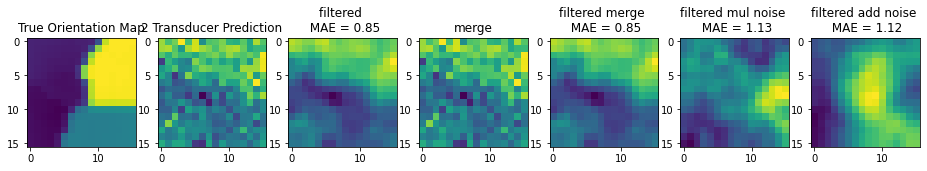

KeyboardInterrupt: ignored

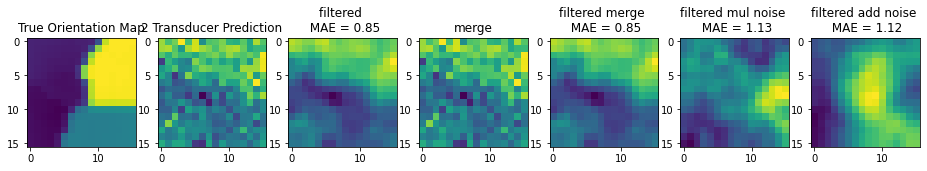

In [ ]:
plt.figure(figsize=(16,8))
for i in range(2500):
    xInd=i
    
    # mod_pred_2trans = np.reshape(trans_2[:,xInd,0,0],[16,16])
    mod_true = np.reshape(output_2trans_test[xInd,:],[16,16]) # CHECK FOR TRAIN OR TEST

    mod_pred_2trans = np.reshape(trans_2[:,xInd, loc_2trans2[0,xInd] ,0],[16,16]) # Shows most similar prediction
    filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
    filter_mae = mean_absolute_error(mod_true, filter_pred)

    merge_im = testing[xInd,:,:]
    filter_merge = cv2.GaussianBlur(merge_im,(3,3),0) # Gaussian smoothing
    merge_mae = mean_absolute_error(mod_true, filter_merge)

    avg_im = avg_merge[xInd,:,:]
    filter_avg = cv2.GaussianBlur(avg_im,(3,3),0) # Gaussian smoothing
    avg_mae = mean_absolute_error(mod_true, filter_avg)

    var_img = pred_var[xInd,:,:] # Variance image
    var_img = cv2.GaussianBlur(var_img,(3,3),0) # Gaussian smoothing

    mul_img = np.reshape(trans_2_mul_100[:,xInd, loc_2trans2_mul_100[0,xInd] ,0],[16,16]) # Shows most similar prediction
    mul_avg = cv2.GaussianBlur(mul_img,(3,3),0) # Gaussian smoothing
    mul_mae = mean_absolute_error(mod_true, mul_avg)

    add_img = np.reshape(trans_2_add_100[:,xInd, loc_2trans2_add_100[0,xInd] ,0],[16,16]) # Shows most similar prediction
    add_avg = cv2.GaussianBlur(add_img,(3,3),0) # Gaussian smoothing
    add_mae = mean_absolute_error(mod_true, add_avg)

    plt.subplot(171)
    plt.imshow(mod_true)
    plt.title('True Orientation Map')
    
    plt.subplot(172)
    plt.imshow(mod_pred_2trans)
    plt.title('2 Transducer Prediction')

    plt.subplot(173)
    plt.imshow(filter_pred)
    plt.title(f'filtered \n MAE = {filter_mae:0.2f}')

    plt.subplot(174)
    plt.imshow(merge_im)
    plt.title('merge')

    plt.subplot(175)
    plt.imshow(filter_merge)
    plt.title(f'filtered merge \n MAE = {merge_mae:0.2f}')

    plt.subplot(176)
    plt.imshow(mul_avg)
    plt.title(f'filtered mul noise \n MAE = {mul_mae:0.2f}')

    plt.subplot(177)
    plt.imshow(add_avg)
    plt.title(f'filtered add noise \n MAE = {add_mae:0.2f}')
    
    display.clear_output(wait=True) 
    display.display(pl.gcf())
    
    time.sleep(1)
    pl.clf()

# Noise Evaluation

In [ ]:
# Save noise data

from google.colab import drive
drive.mount('/content/drive')

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mul_input_test_60.txt', 'wb') as f:
    np.save(f, mul_input_test_60)

with open('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/add_input_test_60.txt', 'wb') as f:
    np.save(f, add_input_test_60)

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# Add multiplicative noise to validation dataset

noise_per = 5 # noise percentage
noise = []
noise_img = []
tmp_input_test = []
lim0 = -math.pi/2
lim1 = math.pi/2
scale = (noise_per*lim1)/100

for i in range(input_2trans_test.shape[0]):
  tmp_input_test.append(input_2trans_test[i,:].copy())
  noise.append(np.random.uniform(-scale, scale, [input_2trans_test.shape[1]]))

tmp_input_test = np.array(tmp_input_test)
noise = np.array(noise)

for i in range(input_2trans_test.shape[0]):
  tmp_input_test[i,:] = tmp_input_test[i,:] + noise[i,:]

  np.putmask(tmp_input_test[i], tmp_input_test[i] < lim0, lim0)
  np.putmask(tmp_input_test[i], tmp_input_test[i] > lim1, lim1)

mul_input_test_5 = tmp_input_test

In [ ]:
# Add additive noise to validation dataset

noise_per = 5 # noise percentage
noise = []
noise_img = []
tmp_input_test = []
lim0 = -math.pi/2
lim1 = math.pi/2
scale = (noise_per*lim1)/100
noise_level = noise_per/100

for i in range(input_2trans_test.shape[0]):
  noise.append(input_2trans_test[i,:].copy())

noise = np.array(noise)

for i in range(input_2trans_test.shape[0]):
  # noise[i,:] = noise[i,:].astype('uint8') 

  tmp_input_test.append(random_noise(noise[i,:], mode='s&p', seed=123, clip=True, amount=noise_level))

add_input_test = tmp_input_test
add_input_test_5 = np.array(add_input_test)

In [ ]:
# Calculate average MAE and SSIM scores Multiplicative Noise
import statistics

tmp_mae_2seed_mul_0 = statistics.mean(mae_pred_2seed)
tmp_ssim_2seed_mul_0 = statistics.mean(ssim_2trans_score_2seed)
tmp_maeDeviation_2seed_mul_0 = statistics.stdev(mae_pred_2seed)
tmp_ssimDeviation_2seed_mul_0 = statistics.stdev(ssim_2trans_score_2seed)

tmp_mae_2seed_mul_5 = statistics.mean(mae_pred_mul_5)
tmp_ssim_2seed_mul_5 = statistics.mean(ssim_2trans_score_mul_5)
tmp_maeDeviation_2seed_mul_5 = statistics.stdev(mae_pred_mul_5)
tmp_ssimDeviation_2seed_mul_5 = statistics.stdev(ssim_2trans_score_mul_5)

tmp_mae_2seed_mul_10 = statistics.mean(mae_pred_mul_10)
tmp_ssim_2seed_mul_10 = statistics.mean(ssim_2trans_score_mul_10)
tmp_maeDeviation_2seed_mul_10 = statistics.stdev(mae_pred_mul_10)
tmp_ssimDeviation_2seed_mul_10 = statistics.stdev(ssim_2trans_score_mul_10)

tmp_mae_2seed_mul_15 = statistics.mean(mae_pred_mul_15)
tmp_ssim_2seed_mul_15 = statistics.mean(ssim_2trans_score_mul_15)
tmp_maeDeviation_2seed_mul_15 = statistics.stdev(mae_pred_mul_15)
tmp_ssimDeviation_2seed_mul_15 = statistics.stdev(ssim_2trans_score_mul_15)

tmp_mae_2seed_mul_20 = statistics.mean(mae_pred_mul_20)
tmp_ssim_2seed_mul_20 = statistics.mean(ssim_2trans_score_mul_20)
tmp_maeDeviation_2seed_mul_20 = statistics.stdev(mae_pred_mul_20)
tmp_ssimDeviation_2seed_mul_20 = statistics.stdev(ssim_2trans_score_mul_20)

tmp_mae_2seed_mul_25 = statistics.mean(mae_pred_mul_25)
tmp_ssim_2seed_mul_25 = statistics.mean(ssim_2trans_score_mul_25)
tmp_maeDeviation_2seed_mul_25 = statistics.stdev(mae_pred_mul_25)
tmp_ssimDeviation_2seed_mul_25 = statistics.stdev(ssim_2trans_score_mul_25)

tmp_mae_2seed_mul_30 = statistics.mean(mae_pred_mul_30)
tmp_ssim_2seed_mul_30 = statistics.mean(ssim_2trans_score_mul_30)
tmp_maeDeviation_2seed_mul_30 = statistics.stdev(mae_pred_mul_30)
tmp_ssimDeviation_2seed_mul_30 = statistics.stdev(ssim_2trans_score_mul_30)

tmp_mae_2seed_mul_35 = statistics.mean(mae_pred_mul_35)
tmp_ssim_2seed_mul_35 = statistics.mean(ssim_2trans_score_mul_35)
tmp_maeDeviation_2seed_mul_35 = statistics.stdev(mae_pred_mul_35)
tmp_ssimDeviation_2seed_mul_35 = statistics.stdev(ssim_2trans_score_mul_35)

tmp_mae_2seed_mul_40 = statistics.mean(mae_pred_mul_40)
tmp_ssim_2seed_mul_40 = statistics.mean(ssim_2trans_score_mul_40)
tmp_maeDeviation_2seed_mul_40 = statistics.stdev(mae_pred_mul_40)
tmp_ssimDeviation_2seed_mul_40 = statistics.stdev(ssim_2trans_score_mul_40)

tmp_mae_2seed_mul_45 = statistics.mean(mae_pred_mul_45)
tmp_ssim_2seed_mul_45 = statistics.mean(ssim_2trans_score_mul_45)
tmp_maeDeviation_2seed_mul_45 = statistics.stdev(mae_pred_mul_45)
tmp_ssimDeviation_2seed_mul_45 = statistics.stdev(ssim_2trans_score_mul_45)

tmp_mae_2seed_mul_50 = statistics.mean(mae_pred_mul_50)
tmp_ssim_2seed_mul_50 = statistics.mean(ssim_2trans_score_mul_50)
tmp_maeDeviation_2seed_mul_50 = statistics.stdev(mae_pred_mul_50)
tmp_ssimDeviation_2seed_mul_50 = statistics.stdev(ssim_2trans_score_mul_50)

tmp_mae_2seed_mul_55 = statistics.mean(mae_pred_mul_55)
tmp_ssim_2seed_mul_55 = statistics.mean(ssim_2trans_score_mul_55)
tmp_maeDeviation_2seed_mul_55 = statistics.stdev(mae_pred_mul_55)
tmp_ssimDeviation_2seed_mul_55 = statistics.stdev(ssim_2trans_score_mul_55)

tmp_mae_2seed_mul_60 = statistics.mean(mae_pred_mul_60)
tmp_ssim_2seed_mul_60 = statistics.mean(ssim_2trans_score_mul_60)
tmp_maeDeviation_2seed_mul_60 = statistics.stdev(mae_pred_mul_60)
tmp_ssimDeviation_2seed_mul_60 = statistics.stdev(ssim_2trans_score_mul_60)

tmp_mae_2seed_mul_65 = statistics.mean(mae_pred_mul_65)
tmp_ssim_2seed_mul_65 = statistics.mean(ssim_2trans_score_mul_65)
tmp_maeDeviation_2seed_mul_65 = statistics.stdev(mae_pred_mul_65)
tmp_ssimDeviation_2seed_mul_65 = statistics.stdev(ssim_2trans_score_mul_65)

tmp_mae_2seed_mul_70 = statistics.mean(mae_pred_mul_70)
tmp_ssim_2seed_mul_70 = statistics.mean(ssim_2trans_score_mul_70)
tmp_maeDeviation_2seed_mul_70 = statistics.stdev(mae_pred_mul_70)
tmp_ssimDeviation_2seed_mul_70 = statistics.stdev(ssim_2trans_score_mul_70)

tmp_mae_2seed_mul_75 = statistics.mean(mae_pred_mul_75)
tmp_ssim_2seed_mul_75 = statistics.mean(ssim_2trans_score_mul_75)
tmp_maeDeviation_2seed_mul_75 = statistics.stdev(mae_pred_mul_75)
tmp_ssimDeviation_2seed_mul_75 = statistics.stdev(ssim_2trans_score_mul_75)

tmp_mae_2seed_mul_80 = statistics.mean(mae_pred_mul_80)
tmp_ssim_2seed_mul_80 = statistics.mean(ssim_2trans_score_mul_80)
tmp_maeDeviation_2seed_mul_80 = statistics.stdev(mae_pred_mul_80)
tmp_ssimDeviation_2seed_mul_80 = statistics.stdev(ssim_2trans_score_mul_80)

tmp_mae_2seed_mul_85 = statistics.mean(mae_pred_mul_85)
tmp_ssim_2seed_mul_85 = statistics.mean(ssim_2trans_score_mul_85)
tmp_maeDeviation_2seed_mul_85 = statistics.stdev(mae_pred_mul_85)
tmp_ssimDeviation_2seed_mul_85 = statistics.stdev(ssim_2trans_score_mul_85)

tmp_mae_2seed_mul_90 = statistics.mean(mae_pred_mul_90)
tmp_ssim_2seed_mul_90 = statistics.mean(ssim_2trans_score_mul_90)
tmp_maeDeviation_2seed_mul_90 = statistics.stdev(mae_pred_mul_90)
tmp_ssimDeviation_2seed_mul_90 = statistics.stdev(ssim_2trans_score_mul_90)

tmp_mae_2seed_mul_95 = statistics.mean(mae_pred_mul_95)
tmp_ssim_2seed_mul_95 = statistics.mean(ssim_2trans_score_mul_95)
tmp_maeDeviation_2seed_mul_95 = statistics.stdev(mae_pred_mul_95)
tmp_ssimDeviation_2seed_mul_95 = statistics.stdev(ssim_2trans_score_mul_95)

tmp_mae_2seed_mul_100 = statistics.mean(mae_pred_mul_100)
tmp_ssim_2seed_mul_100 = statistics.mean(ssim_2trans_score_mul_100)
tmp_maeDeviation_2seed_mul_100 = statistics.stdev(mae_pred_mul_100)
tmp_ssimDeviation_2seed_mul_100 = statistics.stdev(ssim_2trans_score_mul_100)

avg_mae_2seed_mul = [tmp_mae_2seed_mul_0, tmp_mae_2seed_mul_5, tmp_mae_2seed_mul_10, tmp_mae_2seed_mul_15, tmp_mae_2seed_mul_20, tmp_mae_2seed_mul_25, tmp_mae_2seed_mul_30, tmp_mae_2seed_mul_35, tmp_mae_2seed_mul_40, tmp_mae_2seed_mul_45, tmp_mae_2seed_mul_50,
                     tmp_mae_2seed_mul_55, tmp_mae_2seed_mul_60, tmp_mae_2seed_mul_65, tmp_mae_2seed_mul_70, tmp_mae_2seed_mul_75, tmp_mae_2seed_mul_80, tmp_mae_2seed_mul_85, tmp_mae_2seed_mul_90, tmp_mae_2seed_mul_95, tmp_mae_2seed_mul_100,]

avg_ssim_2seed_mul = [tmp_ssim_2seed_mul_0, tmp_ssim_2seed_mul_5, tmp_ssim_2seed_mul_10, tmp_ssim_2seed_mul_15, tmp_ssim_2seed_mul_20, tmp_ssim_2seed_mul_25, tmp_ssim_2seed_mul_30, tmp_ssim_2seed_mul_35, tmp_ssim_2seed_mul_40, tmp_ssim_2seed_mul_45, tmp_ssim_2seed_mul_50,
                     tmp_ssim_2seed_mul_55, tmp_ssim_2seed_mul_60, tmp_ssim_2seed_mul_65, tmp_ssim_2seed_mul_70, tmp_ssim_2seed_mul_75, tmp_ssim_2seed_mul_80, tmp_ssim_2seed_mul_85, tmp_ssim_2seed_mul_90, tmp_ssim_2seed_mul_95, tmp_ssim_2seed_mul_100,]

avg_maeDeviation_2seed_mul = [tmp_maeDeviation_2seed_mul_0, tmp_maeDeviation_2seed_mul_5, tmp_maeDeviation_2seed_mul_10, tmp_maeDeviation_2seed_mul_15, tmp_maeDeviation_2seed_mul_20, tmp_maeDeviation_2seed_mul_25, tmp_maeDeviation_2seed_mul_30, tmp_maeDeviation_2seed_mul_35, tmp_maeDeviation_2seed_mul_40, tmp_maeDeviation_2seed_mul_45, tmp_maeDeviation_2seed_mul_50,
                     tmp_maeDeviation_2seed_mul_55, tmp_maeDeviation_2seed_mul_60, tmp_maeDeviation_2seed_mul_65, tmp_maeDeviation_2seed_mul_70, tmp_maeDeviation_2seed_mul_75, tmp_maeDeviation_2seed_mul_80, tmp_maeDeviation_2seed_mul_85, tmp_maeDeviation_2seed_mul_90, tmp_maeDeviation_2seed_mul_95, tmp_maeDeviation_2seed_mul_100,]

avg_ssimDeviation_2seed_mul = [tmp_ssimDeviation_2seed_mul_0, tmp_ssimDeviation_2seed_mul_5, tmp_ssimDeviation_2seed_mul_10, tmp_ssimDeviation_2seed_mul_15, tmp_ssimDeviation_2seed_mul_20, tmp_ssimDeviation_2seed_mul_25, tmp_ssimDeviation_2seed_mul_30, tmp_ssimDeviation_2seed_mul_35, tmp_ssimDeviation_2seed_mul_40, tmp_ssimDeviation_2seed_mul_45, tmp_ssimDeviation_2seed_mul_50,
                     tmp_ssimDeviation_2seed_mul_55, tmp_ssimDeviation_2seed_mul_60, tmp_ssimDeviation_2seed_mul_65, tmp_ssimDeviation_2seed_mul_70, tmp_ssimDeviation_2seed_mul_75, tmp_ssimDeviation_2seed_mul_80, tmp_ssimDeviation_2seed_mul_85, tmp_ssimDeviation_2seed_mul_90, tmp_ssimDeviation_2seed_mul_95, tmp_ssimDeviation_2seed_mul_100,]

In [ ]:
# Calculate average MAE and SSIM scores Additive Noise
import statistics

tmp_mae_2seed_add_0 = statistics.mean(mae_pred_2seed)
tmp_ssim_2seed_add_0 = statistics.mean(ssim_2trans_score_2seed)
tmp_maeDeviation_2seed_add_0 = statistics.stdev(mae_pred_2seed)
tmp_ssimDeviation_2seed_add_0 = statistics.stdev(ssim_2trans_score_2seed)

tmp_mae_2seed_add_5 = statistics.mean(mae_pred_add_5)
tmp_ssim_2seed_add_5 = statistics.mean(ssim_2trans_score_add_5)
tmp_maeDeviation_2seed_add_5 = statistics.stdev(mae_pred_add_5)
tmp_ssimDeviation_2seed_add_5 = statistics.stdev(ssim_2trans_score_add_5)

tmp_mae_2seed_add_10 = statistics.mean(mae_pred_add_10)
tmp_ssim_2seed_add_10 = statistics.mean(ssim_2trans_score_add_10)
tmp_maeDeviation_2seed_add_10 = statistics.stdev(mae_pred_add_10)
tmp_ssimDeviation_2seed_add_10 = statistics.stdev(ssim_2trans_score_add_10)

tmp_mae_2seed_add_15 = statistics.mean(mae_pred_add_15)
tmp_ssim_2seed_add_15 = statistics.mean(ssim_2trans_score_add_15)
tmp_maeDeviation_2seed_add_15 = statistics.stdev(mae_pred_add_15)
tmp_ssimDeviation_2seed_add_15 = statistics.stdev(ssim_2trans_score_add_15)

tmp_mae_2seed_add_20 = statistics.mean(mae_pred_add_20)
tmp_ssim_2seed_add_20 = statistics.mean(ssim_2trans_score_add_20)
tmp_maeDeviation_2seed_add_20 = statistics.stdev(mae_pred_add_20)
tmp_ssimDeviation_2seed_add_20 = statistics.stdev(ssim_2trans_score_add_20)

tmp_mae_2seed_add_25 = statistics.mean(mae_pred_add_25)
tmp_ssim_2seed_add_25 = statistics.mean(ssim_2trans_score_add_25)
tmp_maeDeviation_2seed_add_25 = statistics.stdev(mae_pred_add_25)
tmp_ssimDeviation_2seed_add_25 = statistics.stdev(ssim_2trans_score_add_25)

tmp_mae_2seed_add_30 = statistics.mean(mae_pred_add_30)
tmp_ssim_2seed_add_30 = statistics.mean(ssim_2trans_score_add_30)
tmp_maeDeviation_2seed_add_30 = statistics.stdev(mae_pred_add_30)
tmp_ssimDeviation_2seed_add_30 = statistics.stdev(ssim_2trans_score_add_30)

tmp_mae_2seed_add_35 = statistics.mean(mae_pred_add_35)
tmp_ssim_2seed_add_35 = statistics.mean(ssim_2trans_score_add_35)
tmp_maeDeviation_2seed_add_35 = statistics.stdev(mae_pred_add_35)
tmp_ssimDeviation_2seed_add_35 = statistics.stdev(ssim_2trans_score_add_35)

tmp_mae_2seed_add_40 = statistics.mean(mae_pred_add_40)
tmp_ssim_2seed_add_40 = statistics.mean(ssim_2trans_score_add_40)
tmp_maeDeviation_2seed_add_40 = statistics.stdev(mae_pred_add_40)
tmp_ssimDeviation_2seed_add_40 = statistics.stdev(ssim_2trans_score_add_40)

tmp_mae_2seed_add_45 = statistics.mean(mae_pred_add_45)
tmp_ssim_2seed_add_45 = statistics.mean(ssim_2trans_score_add_45)
tmp_maeDeviation_2seed_add_45 = statistics.stdev(mae_pred_add_45)
tmp_ssimDeviation_2seed_add_45 = statistics.stdev(ssim_2trans_score_add_45)

tmp_mae_2seed_add_50 = statistics.mean(mae_pred_add_50)
tmp_ssim_2seed_add_50 = statistics.mean(ssim_2trans_score_add_50)
tmp_maeDeviation_2seed_add_50 = statistics.stdev(mae_pred_add_50)
tmp_ssimDeviation_2seed_add_50 = statistics.stdev(ssim_2trans_score_add_50)

tmp_mae_2seed_add_55 = statistics.mean(mae_pred_add_55)
tmp_ssim_2seed_add_55 = statistics.mean(ssim_2trans_score_add_55)
tmp_maeDeviation_2seed_add_55 = statistics.stdev(mae_pred_add_55)
tmp_ssimDeviation_2seed_add_55 = statistics.stdev(ssim_2trans_score_add_55)

tmp_mae_2seed_add_60 = statistics.mean(mae_pred_add_60)
tmp_ssim_2seed_add_60 = statistics.mean(ssim_2trans_score_add_60)
tmp_maeDeviation_2seed_add_60 = statistics.stdev(mae_pred_add_60)
tmp_ssimDeviation_2seed_add_60 = statistics.stdev(ssim_2trans_score_add_60)

tmp_mae_2seed_add_65 = statistics.mean(mae_pred_add_65)
tmp_ssim_2seed_add_65 = statistics.mean(ssim_2trans_score_add_65)
tmp_maeDeviation_2seed_add_65 = statistics.stdev(mae_pred_add_65)
tmp_ssimDeviation_2seed_add_65 = statistics.stdev(ssim_2trans_score_add_65)

tmp_mae_2seed_add_70 = statistics.mean(mae_pred_add_70)
tmp_ssim_2seed_add_70 = statistics.mean(ssim_2trans_score_add_70)
tmp_maeDeviation_2seed_add_70 = statistics.stdev(mae_pred_add_70)
tmp_ssimDeviation_2seed_add_70 = statistics.stdev(ssim_2trans_score_add_70)

tmp_mae_2seed_add_75 = statistics.mean(mae_pred_add_75)
tmp_ssim_2seed_add_75 = statistics.mean(ssim_2trans_score_add_75)
tmp_maeDeviation_2seed_add_75 = statistics.stdev(mae_pred_add_75)
tmp_ssimDeviation_2seed_add_75 = statistics.stdev(ssim_2trans_score_add_75)

tmp_mae_2seed_add_80 = statistics.mean(mae_pred_add_80)
tmp_ssim_2seed_add_80 = statistics.mean(ssim_2trans_score_add_80)
tmp_maeDeviation_2seed_add_80 = statistics.stdev(mae_pred_add_80)
tmp_ssimDeviation_2seed_add_80 = statistics.stdev(ssim_2trans_score_add_80)

tmp_mae_2seed_add_85 = statistics.mean(mae_pred_add_85)
tmp_ssim_2seed_add_85 = statistics.mean(ssim_2trans_score_add_85)
tmp_maeDeviation_2seed_add_85 = statistics.stdev(mae_pred_add_85)
tmp_ssimDeviation_2seed_add_85 = statistics.stdev(ssim_2trans_score_add_85)

tmp_mae_2seed_add_90 = statistics.mean(mae_pred_add_90)
tmp_ssim_2seed_add_90 = statistics.mean(ssim_2trans_score_add_90)
tmp_maeDeviation_2seed_add_90 = statistics.stdev(mae_pred_add_90)
tmp_ssimDeviation_2seed_add_90 = statistics.stdev(ssim_2trans_score_add_90)

tmp_mae_2seed_add_95 = statistics.mean(mae_pred_add_95)
tmp_ssim_2seed_add_95 = statistics.mean(ssim_2trans_score_add_95)
tmp_maeDeviation_2seed_add_95 = statistics.stdev(mae_pred_add_95)
tmp_ssimDeviation_2seed_add_95 = statistics.stdev(ssim_2trans_score_add_95)

tmp_mae_2seed_add_100 = statistics.mean(mae_pred_add_100)
tmp_ssim_2seed_add_100 = statistics.mean(ssim_2trans_score_add_100)
tmp_maeDeviation_2seed_add_100 = statistics.stdev(mae_pred_add_100)
tmp_ssimDeviation_2seed_add_100 = statistics.stdev(ssim_2trans_score_add_100)

avg_mae_2seed_add = [tmp_mae_2seed_add_0, tmp_mae_2seed_add_5, tmp_mae_2seed_add_10, tmp_mae_2seed_add_15, tmp_mae_2seed_add_20, tmp_mae_2seed_add_25, tmp_mae_2seed_add_30, tmp_mae_2seed_add_35, tmp_mae_2seed_add_40, tmp_mae_2seed_add_45, tmp_mae_2seed_add_50,
                     tmp_mae_2seed_add_55, tmp_mae_2seed_add_60, tmp_mae_2seed_add_65, tmp_mae_2seed_add_70, tmp_mae_2seed_add_75, tmp_mae_2seed_add_80, tmp_mae_2seed_add_85, tmp_mae_2seed_add_90, tmp_mae_2seed_add_95, tmp_mae_2seed_add_100,]

avg_ssim_2seed_add = [tmp_ssim_2seed_add_0, tmp_ssim_2seed_add_5, tmp_ssim_2seed_add_10, tmp_ssim_2seed_add_15, tmp_ssim_2seed_add_20, tmp_ssim_2seed_add_25, tmp_ssim_2seed_add_30, tmp_ssim_2seed_add_35, tmp_ssim_2seed_add_40, tmp_ssim_2seed_add_45, tmp_ssim_2seed_add_50,
                     tmp_ssim_2seed_add_55, tmp_ssim_2seed_add_60, tmp_ssim_2seed_add_65, tmp_ssim_2seed_add_70, tmp_ssim_2seed_add_75, tmp_ssim_2seed_add_80, tmp_ssim_2seed_add_85, tmp_ssim_2seed_add_90, tmp_ssim_2seed_add_95, tmp_ssim_2seed_add_100,]

avg_maeDeviation_2seed_add = [tmp_maeDeviation_2seed_add_0, tmp_maeDeviation_2seed_add_5, tmp_maeDeviation_2seed_add_10, tmp_maeDeviation_2seed_add_15, tmp_maeDeviation_2seed_add_20, tmp_maeDeviation_2seed_add_25, tmp_maeDeviation_2seed_add_30, tmp_maeDeviation_2seed_add_35, tmp_maeDeviation_2seed_add_40, tmp_maeDeviation_2seed_add_45, tmp_maeDeviation_2seed_add_50,
                     tmp_maeDeviation_2seed_add_55, tmp_maeDeviation_2seed_add_60, tmp_maeDeviation_2seed_add_65, tmp_maeDeviation_2seed_add_70, tmp_maeDeviation_2seed_add_75, tmp_maeDeviation_2seed_add_80, tmp_maeDeviation_2seed_add_85, tmp_maeDeviation_2seed_add_90, tmp_maeDeviation_2seed_add_95, tmp_maeDeviation_2seed_add_100,]

avg_ssimDeviation_2seed_add = [tmp_ssimDeviation_2seed_add_0, tmp_ssimDeviation_2seed_add_5, tmp_ssimDeviation_2seed_add_10, tmp_ssimDeviation_2seed_add_15, tmp_ssimDeviation_2seed_add_20, tmp_ssimDeviation_2seed_add_25, tmp_ssimDeviation_2seed_add_30, tmp_ssimDeviation_2seed_add_35, tmp_ssimDeviation_2seed_add_40, tmp_ssimDeviation_2seed_add_45, tmp_ssimDeviation_2seed_add_50,
                     tmp_ssimDeviation_2seed_add_55, tmp_ssimDeviation_2seed_add_60, tmp_ssimDeviation_2seed_add_65, tmp_ssimDeviation_2seed_add_70, tmp_ssimDeviation_2seed_add_75, tmp_ssimDeviation_2seed_add_80, tmp_ssimDeviation_2seed_add_85, tmp_ssimDeviation_2seed_add_90, tmp_ssimDeviation_2seed_add_95, tmp_ssimDeviation_2seed_add_100,]

In [ ]:
# Calculate average MAE and SSIM scores Multiplicative Noise
import statistics

tmp_mae_5seed_mul_0 = statistics.mean(mae_pred_5seed)
tmp_ssim_5seed_mul_0 = statistics.mean(ssim_2trans_score_5seed)
tmp_maeDeviation_5seed_mul_0 = statistics.stdev(mae_pred_5seed)
tmp_ssimDeviation_5seed_mul_0 = statistics.stdev(ssim_2trans_score_5seed)

tmp_mae_5seed_mul_5 = statistics.mean(mae_pred_5seed_mul_5)
tmp_ssim_5seed_mul_5 = statistics.mean(ssim_2trans_score_5seed_mul_5)
tmp_maeDeviation_5seed_mul_5 = statistics.stdev(mae_pred_5seed_mul_5)
tmp_ssimDeviation_5seed_mul_5 = statistics.stdev(ssim_2trans_score_5seed_mul_5)

tmp_mae_5seed_mul_10 = statistics.mean(mae_pred_5seed_mul_10)
tmp_ssim_5seed_mul_10 = statistics.mean(ssim_2trans_score_5seed_mul_10)
tmp_maeDeviation_5seed_mul_10 = statistics.stdev(mae_pred_5seed_mul_10)
tmp_ssimDeviation_5seed_mul_10 = statistics.stdev(ssim_2trans_score_5seed_mul_10)

tmp_mae_5seed_mul_15 = statistics.mean(mae_pred_5seed_mul_15)
tmp_ssim_5seed_mul_15 = statistics.mean(ssim_2trans_score_5seed_mul_15)
tmp_maeDeviation_5seed_mul_15 = statistics.stdev(mae_pred_5seed_mul_15)
tmp_ssimDeviation_5seed_mul_15 = statistics.stdev(ssim_2trans_score_5seed_mul_15)

tmp_mae_5seed_mul_20 = statistics.mean(mae_pred_5seed_mul_20)
tmp_ssim_5seed_mul_20 = statistics.mean(ssim_2trans_score_5seed_mul_20)
tmp_maeDeviation_5seed_mul_20 = statistics.stdev(mae_pred_5seed_mul_20)
tmp_ssimDeviation_5seed_mul_20 = statistics.stdev(ssim_2trans_score_5seed_mul_20)

tmp_mae_5seed_mul_25 = statistics.mean(mae_pred_5seed_mul_25)
tmp_ssim_5seed_mul_25 = statistics.mean(ssim_2trans_score_5seed_mul_25)
tmp_maeDeviation_5seed_mul_25 = statistics.stdev(mae_pred_5seed_mul_25)
tmp_ssimDeviation_5seed_mul_25 = statistics.stdev(ssim_2trans_score_5seed_mul_25)

tmp_mae_5seed_mul_30 = statistics.mean(mae_pred_5seed_mul_30)
tmp_ssim_5seed_mul_30 = statistics.mean(ssim_2trans_score_5seed_mul_30)
tmp_maeDeviation_5seed_mul_30 = statistics.stdev(mae_pred_5seed_mul_30)
tmp_ssimDeviation_5seed_mul_30 = statistics.stdev(ssim_2trans_score_5seed_mul_30)

tmp_mae_5seed_mul_35 = statistics.mean(mae_pred_5seed_mul_35)
tmp_ssim_5seed_mul_35 = statistics.mean(ssim_2trans_score_5seed_mul_35)
tmp_maeDeviation_5seed_mul_35 = statistics.stdev(mae_pred_5seed_mul_35)
tmp_ssimDeviation_5seed_mul_35 = statistics.stdev(ssim_2trans_score_5seed_mul_35)

tmp_mae_5seed_mul_40 = statistics.mean(mae_pred_5seed_mul_40)
tmp_ssim_5seed_mul_40 = statistics.mean(ssim_2trans_score_5seed_mul_40)
tmp_maeDeviation_5seed_mul_40 = statistics.stdev(mae_pred_5seed_mul_40)
tmp_ssimDeviation_5seed_mul_40 = statistics.stdev(ssim_2trans_score_5seed_mul_40)

tmp_mae_5seed_mul_45 = statistics.mean(mae_pred_5seed_mul_45)
tmp_ssim_5seed_mul_45 = statistics.mean(ssim_2trans_score_5seed_mul_45)
tmp_maeDeviation_5seed_mul_45 = statistics.stdev(mae_pred_5seed_mul_45)
tmp_ssimDeviation_5seed_mul_45 = statistics.stdev(ssim_2trans_score_5seed_mul_45)

tmp_mae_5seed_mul_50 = statistics.mean(mae_pred_5seed_mul_50)
tmp_ssim_5seed_mul_50 = statistics.mean(ssim_2trans_score_5seed_mul_50)
tmp_maeDeviation_5seed_mul_50 = statistics.stdev(mae_pred_5seed_mul_50)
tmp_ssimDeviation_5seed_mul_50 = statistics.stdev(ssim_2trans_score_5seed_mul_50)

tmp_mae_5seed_mul_55 = statistics.mean(mae_pred_5seed_mul_55)
tmp_ssim_5seed_mul_55 = statistics.mean(ssim_2trans_score_5seed_mul_55)
tmp_maeDeviation_5seed_mul_55 = statistics.stdev(mae_pred_5seed_mul_55)
tmp_ssimDeviation_5seed_mul_55 = statistics.stdev(ssim_2trans_score_5seed_mul_55)

tmp_mae_5seed_mul_60 = statistics.mean(mae_pred_5seed_mul_60)
tmp_ssim_5seed_mul_60 = statistics.mean(ssim_2trans_score_5seed_mul_60)
tmp_maeDeviation_5seed_mul_60 = statistics.stdev(mae_pred_5seed_mul_60)
tmp_ssimDeviation_5seed_mul_60 = statistics.stdev(ssim_2trans_score_5seed_mul_60)

tmp_mae_5seed_mul_65 = statistics.mean(mae_pred_5seed_mul_65)
tmp_ssim_5seed_mul_65 = statistics.mean(ssim_2trans_score_5seed_mul_65)
tmp_maeDeviation_5seed_mul_65 = statistics.stdev(mae_pred_5seed_mul_65)
tmp_ssimDeviation_5seed_mul_65 = statistics.stdev(ssim_2trans_score_5seed_mul_65)

tmp_mae_5seed_mul_70 = statistics.mean(mae_pred_5seed_mul_70)
tmp_ssim_5seed_mul_70 = statistics.mean(ssim_2trans_score_5seed_mul_70)
tmp_maeDeviation_5seed_mul_70 = statistics.stdev(mae_pred_5seed_mul_70)
tmp_ssimDeviation_5seed_mul_70 = statistics.stdev(ssim_2trans_score_5seed_mul_70)

tmp_mae_5seed_mul_75 = statistics.mean(mae_pred_5seed_mul_75)
tmp_ssim_5seed_mul_75 = statistics.mean(ssim_2trans_score_5seed_mul_75)
tmp_maeDeviation_5seed_mul_75 = statistics.stdev(mae_pred_5seed_mul_75)
tmp_ssimDeviation_5seed_mul_75 = statistics.stdev(ssim_2trans_score_5seed_mul_75)

tmp_mae_5seed_mul_80 = statistics.mean(mae_pred_5seed_mul_80)
tmp_ssim_5seed_mul_80 = statistics.mean(ssim_2trans_score_5seed_mul_80)
tmp_maeDeviation_5seed_mul_80 = statistics.stdev(mae_pred_5seed_mul_80)
tmp_ssimDeviation_5seed_mul_80 = statistics.stdev(ssim_2trans_score_5seed_mul_80)

tmp_mae_5seed_mul_85 = statistics.mean(mae_pred_5seed_mul_85)
tmp_ssim_5seed_mul_85 = statistics.mean(ssim_2trans_score_5seed_mul_85)
tmp_maeDeviation_5seed_mul_85 = statistics.stdev(mae_pred_5seed_mul_85)
tmp_ssimDeviation_5seed_mul_85 = statistics.stdev(ssim_2trans_score_5seed_mul_85)

tmp_mae_5seed_mul_90 = statistics.mean(mae_pred_5seed_mul_90)
tmp_ssim_5seed_mul_90 = statistics.mean(ssim_2trans_score_5seed_mul_90)
tmp_maeDeviation_5seed_mul_90 = statistics.stdev(mae_pred_5seed_mul_90)
tmp_ssimDeviation_5seed_mul_90 = statistics.stdev(ssim_2trans_score_5seed_mul_90)

tmp_mae_5seed_mul_95 = statistics.mean(mae_pred_5seed_mul_95)
tmp_ssim_5seed_mul_95 = statistics.mean(ssim_2trans_score_5seed_mul_95)
tmp_maeDeviation_5seed_mul_95 = statistics.stdev(mae_pred_5seed_mul_95)
tmp_ssimDeviation_5seed_mul_95 = statistics.stdev(ssim_2trans_score_5seed_mul_95)

tmp_mae_5seed_mul_100 = statistics.mean(mae_pred_5seed_mul_100)
tmp_ssim_5seed_mul_100 = statistics.mean(ssim_2trans_score_5seed_mul_100)
tmp_maeDeviation_5seed_mul_100 = statistics.stdev(mae_pred_5seed_mul_100)
tmp_ssimDeviation_5seed_mul_100 = statistics.stdev(ssim_2trans_score_5seed_mul_100)

avg_mae_5seed_mul = [tmp_mae_5seed_mul_0, tmp_mae_5seed_mul_5, tmp_mae_5seed_mul_10, tmp_mae_5seed_mul_15, tmp_mae_5seed_mul_20, tmp_mae_5seed_mul_25, tmp_mae_5seed_mul_30, tmp_mae_5seed_mul_35, tmp_mae_5seed_mul_40, tmp_mae_5seed_mul_45, tmp_mae_5seed_mul_50,
                     tmp_mae_5seed_mul_55, tmp_mae_5seed_mul_60, tmp_mae_5seed_mul_65, tmp_mae_5seed_mul_70, tmp_mae_5seed_mul_75, tmp_mae_5seed_mul_80, tmp_mae_5seed_mul_85, tmp_mae_5seed_mul_90, tmp_mae_5seed_mul_95, tmp_mae_5seed_mul_100,]

avg_ssim_5seed_mul = [tmp_ssim_5seed_mul_0, tmp_ssim_5seed_mul_5, tmp_ssim_5seed_mul_10, tmp_ssim_5seed_mul_15, tmp_ssim_5seed_mul_20, tmp_ssim_5seed_mul_25, tmp_ssim_5seed_mul_30, tmp_ssim_5seed_mul_35, tmp_ssim_5seed_mul_40, tmp_ssim_5seed_mul_45, tmp_ssim_5seed_mul_50,
                     tmp_ssim_5seed_mul_55, tmp_ssim_5seed_mul_60, tmp_ssim_5seed_mul_65, tmp_ssim_5seed_mul_70, tmp_ssim_5seed_mul_75, tmp_ssim_5seed_mul_80, tmp_ssim_5seed_mul_85, tmp_ssim_5seed_mul_90, tmp_ssim_5seed_mul_95, tmp_ssim_5seed_mul_100,]

avg_maeDeviation_5seed_mul = [tmp_maeDeviation_5seed_mul_0, tmp_maeDeviation_5seed_mul_5, tmp_maeDeviation_5seed_mul_10, tmp_maeDeviation_5seed_mul_15, tmp_maeDeviation_5seed_mul_20, tmp_maeDeviation_5seed_mul_25, tmp_maeDeviation_5seed_mul_30, tmp_maeDeviation_5seed_mul_35, tmp_maeDeviation_5seed_mul_40, tmp_maeDeviation_5seed_mul_45, tmp_maeDeviation_5seed_mul_50,
                     tmp_maeDeviation_5seed_mul_55, tmp_maeDeviation_5seed_mul_60, tmp_maeDeviation_5seed_mul_65, tmp_maeDeviation_5seed_mul_70, tmp_maeDeviation_5seed_mul_75, tmp_maeDeviation_5seed_mul_80, tmp_maeDeviation_5seed_mul_85, tmp_maeDeviation_5seed_mul_90, tmp_maeDeviation_5seed_mul_95, tmp_maeDeviation_5seed_mul_100,]

avg_ssimDeviation_5seed_mul = [tmp_ssimDeviation_5seed_mul_0, tmp_ssimDeviation_5seed_mul_5, tmp_ssimDeviation_5seed_mul_10, tmp_ssimDeviation_5seed_mul_15, tmp_ssimDeviation_5seed_mul_20, tmp_ssimDeviation_5seed_mul_25, tmp_ssimDeviation_5seed_mul_30, tmp_ssimDeviation_5seed_mul_35, tmp_ssimDeviation_5seed_mul_40, tmp_ssimDeviation_5seed_mul_45, tmp_ssimDeviation_5seed_mul_50,
                     tmp_ssimDeviation_5seed_mul_55, tmp_ssimDeviation_5seed_mul_60, tmp_ssimDeviation_5seed_mul_65, tmp_ssimDeviation_5seed_mul_70, tmp_ssimDeviation_5seed_mul_75, tmp_ssimDeviation_5seed_mul_80, tmp_ssimDeviation_5seed_mul_85, tmp_ssimDeviation_5seed_mul_90, tmp_ssimDeviation_5seed_mul_95, tmp_ssimDeviation_5seed_mul_100,]

In [ ]:
# Calculate average MAE and SSIM scores Additive Noise
import statistics

tmp_mae_5seed_add_0 = statistics.mean(mae_pred_5seed)
tmp_ssim_5seed_add_0 = statistics.mean(ssim_2trans_score_5seed)
tmp_maeDeviation_5seed_add_0 = statistics.stdev(mae_pred_5seed)
tmp_ssimDeviation_5seed_add_0 = statistics.stdev(ssim_2trans_score_5seed)

tmp_mae_5seed_add_5 = statistics.mean(mae_pred_5seed_add_5)
tmp_ssim_5seed_add_5 = statistics.mean(ssim_2trans_score_5seed_add_5)
tmp_maeDeviation_5seed_add_5 = statistics.stdev(mae_pred_5seed_add_5)
tmp_ssimDeviation_5seed_add_5 = statistics.stdev(ssim_2trans_score_5seed_add_5)

tmp_mae_5seed_add_10 = statistics.mean(mae_pred_5seed_add_10)
tmp_ssim_5seed_add_10 = statistics.mean(ssim_2trans_score_5seed_add_10)
tmp_maeDeviation_5seed_add_10 = statistics.stdev(mae_pred_5seed_add_10)
tmp_ssimDeviation_5seed_add_10 = statistics.stdev(ssim_2trans_score_5seed_add_10)

tmp_mae_5seed_add_15 = statistics.mean(mae_pred_5seed_add_15)
tmp_ssim_5seed_add_15 = statistics.mean(ssim_2trans_score_5seed_add_15)
tmp_maeDeviation_5seed_add_15 = statistics.stdev(mae_pred_5seed_add_15)
tmp_ssimDeviation_5seed_add_15 = statistics.stdev(ssim_2trans_score_5seed_add_15)

tmp_mae_5seed_add_20 = statistics.mean(mae_pred_5seed_add_20)
tmp_ssim_5seed_add_20 = statistics.mean(ssim_2trans_score_5seed_add_20)
tmp_maeDeviation_5seed_add_20 = statistics.stdev(mae_pred_5seed_add_20)
tmp_ssimDeviation_5seed_add_20 = statistics.stdev(ssim_2trans_score_5seed_add_20)

tmp_mae_5seed_add_25 = statistics.mean(mae_pred_5seed_add_25)
tmp_ssim_5seed_add_25 = statistics.mean(ssim_2trans_score_5seed_add_25)
tmp_maeDeviation_5seed_add_25 = statistics.stdev(mae_pred_5seed_add_25)
tmp_ssimDeviation_5seed_add_25 = statistics.stdev(ssim_2trans_score_5seed_add_25)

tmp_mae_5seed_add_30 = statistics.mean(mae_pred_5seed_add_30)
tmp_ssim_5seed_add_30 = statistics.mean(ssim_2trans_score_5seed_add_30)
tmp_maeDeviation_5seed_add_30 = statistics.stdev(mae_pred_5seed_add_30)
tmp_ssimDeviation_5seed_add_30 = statistics.stdev(ssim_2trans_score_5seed_add_30)

tmp_mae_5seed_add_35 = statistics.mean(mae_pred_5seed_add_35)
tmp_ssim_5seed_add_35 = statistics.mean(ssim_2trans_score_5seed_add_35)
tmp_maeDeviation_5seed_add_35 = statistics.stdev(mae_pred_5seed_add_35)
tmp_ssimDeviation_5seed_add_35 = statistics.stdev(ssim_2trans_score_5seed_add_35)

tmp_mae_5seed_add_40 = statistics.mean(mae_pred_5seed_add_40)
tmp_ssim_5seed_add_40 = statistics.mean(ssim_2trans_score_5seed_add_40)
tmp_maeDeviation_5seed_add_40 = statistics.stdev(mae_pred_5seed_add_40)
tmp_ssimDeviation_5seed_add_40 = statistics.stdev(ssim_2trans_score_5seed_add_40)

tmp_mae_5seed_add_45 = statistics.mean(mae_pred_5seed_add_45)
tmp_ssim_5seed_add_45 = statistics.mean(ssim_2trans_score_5seed_add_45)
tmp_maeDeviation_5seed_add_45 = statistics.stdev(mae_pred_5seed_add_45)
tmp_ssimDeviation_5seed_add_45 = statistics.stdev(ssim_2trans_score_5seed_add_45)

tmp_mae_5seed_add_50 = statistics.mean(mae_pred_5seed_add_50)
tmp_ssim_5seed_add_50 = statistics.mean(ssim_2trans_score_5seed_add_50)
tmp_maeDeviation_5seed_add_50 = statistics.stdev(mae_pred_5seed_add_50)
tmp_ssimDeviation_5seed_add_50 = statistics.stdev(ssim_2trans_score_5seed_add_50)

tmp_mae_5seed_add_55 = statistics.mean(mae_pred_5seed_add_55)
tmp_ssim_5seed_add_55 = statistics.mean(ssim_2trans_score_5seed_add_55)
tmp_maeDeviation_5seed_add_55 = statistics.stdev(mae_pred_5seed_add_55)
tmp_ssimDeviation_5seed_add_55 = statistics.stdev(ssim_2trans_score_5seed_add_55)

tmp_mae_5seed_add_60 = statistics.mean(mae_pred_5seed_add_60)
tmp_ssim_5seed_add_60 = statistics.mean(ssim_2trans_score_5seed_add_60)
tmp_maeDeviation_5seed_add_60 = statistics.stdev(mae_pred_5seed_add_60)
tmp_ssimDeviation_5seed_add_60 = statistics.stdev(ssim_2trans_score_5seed_add_60)

tmp_mae_5seed_add_65 = statistics.mean(mae_pred_5seed_add_65)
tmp_ssim_5seed_add_65 = statistics.mean(ssim_2trans_score_5seed_add_65)
tmp_maeDeviation_5seed_add_65 = statistics.stdev(mae_pred_5seed_add_65)
tmp_ssimDeviation_5seed_add_65 = statistics.stdev(ssim_2trans_score_5seed_add_65)

tmp_mae_5seed_add_70 = statistics.mean(mae_pred_5seed_add_70)
tmp_ssim_5seed_add_70 = statistics.mean(ssim_2trans_score_5seed_add_70)
tmp_maeDeviation_5seed_add_70 = statistics.stdev(mae_pred_5seed_add_70)
tmp_ssimDeviation_5seed_add_70 = statistics.stdev(ssim_2trans_score_5seed_add_70)

tmp_mae_5seed_add_75 = statistics.mean(mae_pred_5seed_add_75)
tmp_ssim_5seed_add_75 = statistics.mean(ssim_2trans_score_5seed_add_75)
tmp_maeDeviation_5seed_add_75 = statistics.stdev(mae_pred_5seed_add_75)
tmp_ssimDeviation_5seed_add_75 = statistics.stdev(ssim_2trans_score_5seed_add_75)

tmp_mae_5seed_add_80 = statistics.mean(mae_pred_5seed_add_80)
tmp_ssim_5seed_add_80 = statistics.mean(ssim_2trans_score_5seed_add_80)
tmp_maeDeviation_5seed_add_80 = statistics.stdev(mae_pred_5seed_add_80)
tmp_ssimDeviation_5seed_add_80 = statistics.stdev(ssim_2trans_score_5seed_add_80)

tmp_mae_5seed_add_85 = statistics.mean(mae_pred_5seed_add_85)
tmp_ssim_5seed_add_85 = statistics.mean(ssim_2trans_score_5seed_add_85)
tmp_maeDeviation_5seed_add_85 = statistics.stdev(mae_pred_5seed_add_85)
tmp_ssimDeviation_5seed_add_85 = statistics.stdev(ssim_2trans_score_5seed_add_85)

tmp_mae_5seed_add_90 = statistics.mean(mae_pred_5seed_add_90)
tmp_ssim_5seed_add_90 = statistics.mean(ssim_2trans_score_5seed_add_90)
tmp_maeDeviation_5seed_add_90 = statistics.stdev(mae_pred_5seed_add_90)
tmp_ssimDeviation_5seed_add_90 = statistics.stdev(ssim_2trans_score_5seed_add_90)

tmp_mae_5seed_add_95 = statistics.mean(mae_pred_5seed_add_95)
tmp_ssim_5seed_add_95 = statistics.mean(ssim_2trans_score_5seed_add_95)
tmp_maeDeviation_5seed_add_95 = statistics.stdev(mae_pred_5seed_add_95)
tmp_ssimDeviation_5seed_add_95 = statistics.stdev(ssim_2trans_score_5seed_add_95)

tmp_mae_5seed_add_100 = statistics.mean(mae_pred_5seed_add_100)
tmp_ssim_5seed_add_100 = statistics.mean(ssim_2trans_score_5seed_add_100)
tmp_maeDeviation_5seed_add_100 = statistics.stdev(mae_pred_5seed_add_100)
tmp_ssimDeviation_5seed_add_100 = statistics.stdev(ssim_2trans_score_5seed_add_100)

avg_mae_5seed_add = [tmp_mae_5seed_add_0, tmp_mae_5seed_add_5, tmp_mae_5seed_add_10, tmp_mae_5seed_add_15, tmp_mae_5seed_add_20, tmp_mae_5seed_add_25, tmp_mae_5seed_add_30, tmp_mae_5seed_add_35, tmp_mae_5seed_add_40, tmp_mae_5seed_add_45, tmp_mae_5seed_add_50,
                     tmp_mae_5seed_add_55, tmp_mae_5seed_add_60, tmp_mae_5seed_add_65, tmp_mae_5seed_add_70, tmp_mae_5seed_add_75, tmp_mae_5seed_add_80, tmp_mae_5seed_add_85, tmp_mae_5seed_add_90, tmp_mae_5seed_add_95, tmp_mae_5seed_add_100,]

avg_ssim_5seed_add = [tmp_ssim_5seed_add_0, tmp_ssim_5seed_add_5, tmp_ssim_5seed_add_10, tmp_ssim_5seed_add_15, tmp_ssim_5seed_add_20, tmp_ssim_5seed_add_25, tmp_ssim_5seed_add_30, tmp_ssim_5seed_add_35, tmp_ssim_5seed_add_40, tmp_ssim_5seed_add_45, tmp_ssim_5seed_add_50,
                     tmp_ssim_5seed_add_55, tmp_ssim_5seed_add_60, tmp_ssim_5seed_add_65, tmp_ssim_5seed_add_70, tmp_ssim_5seed_add_75, tmp_ssim_5seed_add_80, tmp_ssim_5seed_add_85, tmp_ssim_5seed_add_90, tmp_ssim_5seed_add_95, tmp_ssim_5seed_add_100,]

avg_maeDeviation_5seed_add = [tmp_maeDeviation_5seed_add_0, tmp_maeDeviation_5seed_add_5, tmp_maeDeviation_5seed_add_10, tmp_maeDeviation_5seed_add_15, tmp_maeDeviation_5seed_add_20, tmp_maeDeviation_5seed_add_25, tmp_maeDeviation_5seed_add_30, tmp_maeDeviation_5seed_add_35, tmp_maeDeviation_5seed_add_40, tmp_maeDeviation_5seed_add_45, tmp_maeDeviation_5seed_add_50,
                     tmp_maeDeviation_5seed_add_55, tmp_maeDeviation_5seed_add_60, tmp_maeDeviation_5seed_add_65, tmp_maeDeviation_5seed_add_70, tmp_maeDeviation_5seed_add_75, tmp_maeDeviation_5seed_add_80, tmp_maeDeviation_5seed_add_85, tmp_maeDeviation_5seed_add_90, tmp_maeDeviation_5seed_add_95, tmp_maeDeviation_5seed_add_100,]

avg_ssimDeviation_5seed_add = [tmp_ssimDeviation_5seed_add_0, tmp_ssimDeviation_5seed_add_5, tmp_ssimDeviation_5seed_add_10, tmp_ssimDeviation_5seed_add_15, tmp_ssimDeviation_5seed_add_20, tmp_ssimDeviation_5seed_add_25, tmp_ssimDeviation_5seed_add_30, tmp_ssimDeviation_5seed_add_35, tmp_ssimDeviation_5seed_add_40, tmp_ssimDeviation_5seed_add_45, tmp_ssimDeviation_5seed_add_50,
                     tmp_ssimDeviation_5seed_add_55, tmp_ssimDeviation_5seed_add_60, tmp_ssimDeviation_5seed_add_65, tmp_ssimDeviation_5seed_add_70, tmp_ssimDeviation_5seed_add_75, tmp_ssimDeviation_5seed_add_80, tmp_ssimDeviation_5seed_add_85, tmp_ssimDeviation_5seed_add_90, tmp_ssimDeviation_5seed_add_95, tmp_ssimDeviation_5seed_add_100,]

Text(0, 0.5, 'Average SSIM')

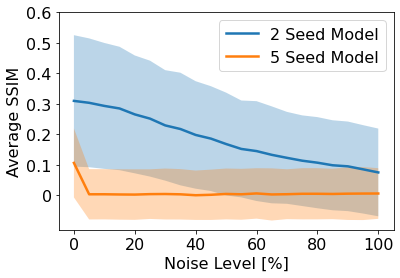

In [ ]:
maeDevMinus2 = []
maeDevPlus2 = []
ssimDevMinus2 = []
ssimDevPlus2 = []
maeDevMinus5 = []
maeDevPlus5 = []
ssimDevMinus5 = []
ssimDevPlus5 = []

# plt.figure(figsize=(16,8))

width = 2.5
f_size = 16

x = np.linspace(0,100,21)

for i in range(21):
  maeDevMinus2.append(avg_mae_2seed_mul[i] - avg_maeDeviation_2seed_mul[i])
  maeDevPlus2.append(avg_mae_2seed_mul[i] + avg_maeDeviation_2seed_mul[i])
  ssimDevMinus2.append(avg_ssim_2seed_mul[i] - avg_ssimDeviation_2seed_mul[i])
  ssimDevPlus2.append(avg_ssim_2seed_mul[i] + avg_ssimDeviation_2seed_mul[i])

  maeDevMinus5.append(avg_mae_5seed_mul[i] - avg_maeDeviation_5seed_mul[i])
  maeDevPlus5.append(avg_mae_5seed_mul[i] + avg_maeDeviation_5seed_mul[i])
  ssimDevMinus5.append(avg_ssim_5seed_mul[i] - avg_ssimDeviation_5seed_mul[i])
  ssimDevPlus5.append(avg_ssim_5seed_mul[i] + avg_ssimDeviation_5seed_mul[i])



# plt.plot(x, avg_mae_2seed_mul, label = r'2 Seed Model', linewidth=width)
# plt.plot(x, avg_mae_5seed_mul, label = r'5 Seed Model', linewidth=width)
plt.plot(x, avg_ssim_2seed_mul, label = r'2 Seed Model', linewidth=width)
plt.plot(x, avg_ssim_5seed_mul, label = r'5 Seed Model', linewidth=width)
plt.fill_between(x, ssimDevMinus2, ssimDevPlus2, alpha=0.3)
plt.fill_between(x, ssimDevMinus5, ssimDevPlus5, alpha=0.3)

x = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
xticks = x
plt.xticks(fontsize=f_size)
plt.yticks(x, xticks, fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
plt.xlabel('Noise Level [%]', fontsize=f_size)
plt.ylabel('Average SSIM', fontsize=f_size)

Text(0, 0.5, 'Average MAE')

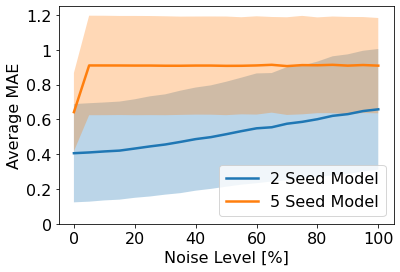

In [ ]:
maeDevMinus2 = []
maeDevPlus2 = []
ssimDevMinus2 = []
ssimDevPlus2 = []
maeDevMinus5 = []
maeDevPlus5 = []
ssimDevMinus5 = []
ssimDevPlus5 = []

# plt.figure(figsize=(16,8))

width = 2.5
f_size = 16

x = np.linspace(0,100,21)

for i in range(21):
  maeDevMinus2.append(avg_mae_2seed_mul[i] - avg_maeDeviation_2seed_mul[i])
  maeDevPlus2.append(avg_mae_2seed_mul[i] + avg_maeDeviation_2seed_mul[i])
  ssimDevMinus2.append(avg_ssim_2seed_mul[i] - avg_ssimDeviation_2seed_mul[i])
  ssimDevPlus2.append(avg_ssim_2seed_mul[i] + avg_ssimDeviation_2seed_mul[i])

  maeDevMinus5.append(avg_mae_5seed_mul[i] - avg_maeDeviation_5seed_mul[i])
  maeDevPlus5.append(avg_mae_5seed_mul[i] + avg_maeDeviation_5seed_mul[i])
  ssimDevMinus5.append(avg_ssim_5seed_mul[i] - avg_ssimDeviation_5seed_mul[i])
  ssimDevPlus5.append(avg_ssim_5seed_mul[i] + avg_ssimDeviation_5seed_mul[i])



plt.plot(x, avg_mae_2seed_mul, label = r'2 Seed Model', linewidth=width)
plt.plot(x, avg_mae_5seed_mul, label = r'5 Seed Model', linewidth=width)
# plt.plot(x, avg_ssim_2seed_mul, label = r'2 Seed Model', linewidth=width)
# plt.plot(x, avg_ssim_5seed_mul, label = r'5 Seed Model', linewidth=width)
plt.fill_between(x, maeDevMinus2, maeDevPlus2, alpha=0.3)
plt.fill_between(x, maeDevMinus5, maeDevPlus5, alpha=0.3)

x = [0, 0.2, 0.4, 0.6, 0.8, 1, 1.2]
xticks = x
plt.xticks(fontsize=f_size)
plt.yticks(x, xticks, fontsize=f_size)
plt.legend(fontsize=f_size, loc="lower right")
plt.xlabel('Noise Level [%]', fontsize=f_size)
plt.ylabel('Average MAE', fontsize=f_size)

Text(0, 0.5, 'Average SSIM')

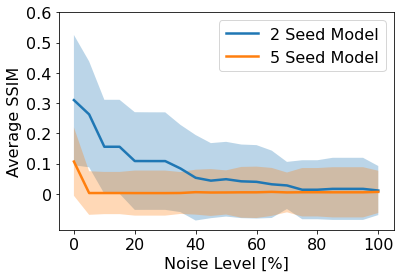

In [ ]:
maeDevMinus2 = []
maeDevPlus2 = []
ssimDevMinus2 = []
ssimDevPlus2 = []
maeDevMinus5 = []
maeDevPlus5 = []
ssimDevMinus5 = []
ssimDevPlus5 = []

# plt.figure(figsize=(16,8))

width = 2.5
f_size = 16

x = np.linspace(0,100,21)

for i in range(21):
  maeDevMinus2.append(avg_mae_2seed_add[i] - avg_maeDeviation_2seed_add[i])
  maeDevPlus2.append(avg_mae_2seed_add[i] + avg_maeDeviation_2seed_add[i])
  ssimDevMinus2.append(avg_ssim_2seed_add[i] - avg_ssimDeviation_2seed_add[i])
  ssimDevPlus2.append(avg_ssim_2seed_add[i] + avg_ssimDeviation_2seed_add[i])

  maeDevMinus5.append(avg_mae_5seed_add[i] - avg_maeDeviation_5seed_add[i])
  maeDevPlus5.append(avg_mae_5seed_add[i] + avg_maeDeviation_5seed_add[i])
  ssimDevMinus5.append(avg_ssim_5seed_add[i] - avg_ssimDeviation_5seed_add[i])
  ssimDevPlus5.append(avg_ssim_5seed_add[i] + avg_ssimDeviation_5seed_add[i])



# plt.plot(x, avg_mae_2seed_add, label = r'2 Seed Model', linewidth=width)
# plt.plot(x, avg_mae_5seed_add, label = r'5 Seed Model', linewidth=width)
plt.plot(x, avg_ssim_2seed_add, label = r'2 Seed Model', linewidth=width)
plt.plot(x, avg_ssim_5seed_add, label = r'5 Seed Model', linewidth=width)
plt.fill_between(x, ssimDevMinus2, ssimDevPlus2, alpha=0.3)
plt.fill_between(x, ssimDevMinus5, ssimDevPlus5, alpha=0.3)

x = [0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6]
xticks = x
plt.xticks(fontsize=f_size)
plt.yticks(x, xticks, fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
plt.xlabel('Noise Level [%]', fontsize=f_size)
plt.ylabel('Average SSIM', fontsize=f_size)

Text(0, 0.5, 'Average MAE')

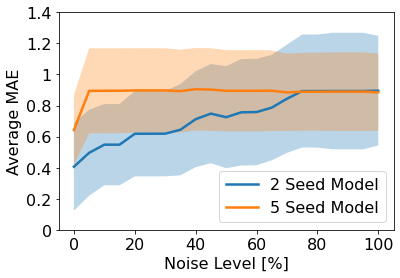

In [ ]:
maeDevMinus2 = []
maeDevPlus2 = []
ssimDevMinus2 = []
ssimDevPlus2 = []
maeDevMinus5 = []
maeDevPlus5 = []
ssimDevMinus5 = []
ssimDevPlus5 = []

# plt.figure(figsize=(16,8))

width = 2.5
f_size = 16

x = np.linspace(0,100,21)

for i in range(21):
  maeDevMinus2.append(avg_mae_2seed_add[i] - avg_maeDeviation_2seed_add[i])
  maeDevPlus2.append(avg_mae_2seed_add[i] + avg_maeDeviation_2seed_add[i])
  ssimDevMinus2.append(avg_ssim_2seed_add[i] - avg_ssimDeviation_2seed_add[i])
  ssimDevPlus2.append(avg_ssim_2seed_add[i] + avg_ssimDeviation_2seed_add[i])

  maeDevMinus5.append(avg_mae_5seed_add[i] - avg_maeDeviation_5seed_add[i])
  maeDevPlus5.append(avg_mae_5seed_add[i] + avg_maeDeviation_5seed_add[i])
  ssimDevMinus5.append(avg_ssim_5seed_add[i] - avg_ssimDeviation_5seed_add[i])
  ssimDevPlus5.append(avg_ssim_5seed_add[i] + avg_ssimDeviation_5seed_add[i])



plt.plot(x, avg_mae_2seed_add, label = r'2 Seed Model', linewidth=width)
plt.plot(x, avg_mae_5seed_add, label = r'5 Seed Model', linewidth=width)
# plt.plot(x, avg_ssim_2seed_add, label = r'2 Seed Model', linewidth=width)
# plt.plot(x, avg_ssim_5seed_add, label = r'5 Seed Model', linewidth=width)
plt.fill_between(x, maeDevMinus2, maeDevPlus2, alpha=0.3)
plt.fill_between(x, maeDevMinus5, maeDevPlus5, alpha=0.3)

x = [0, 0.2, 0.4, 0.6, 0.8, 1, 1.2, 1.4]
xticks = x
plt.xticks(fontsize=f_size)
plt.yticks(x, xticks, fontsize=f_size)
plt.legend(fontsize=f_size, loc="lower right")
plt.xlabel('Noise Level [%]', fontsize=f_size)
plt.ylabel('Average MAE', fontsize=f_size)

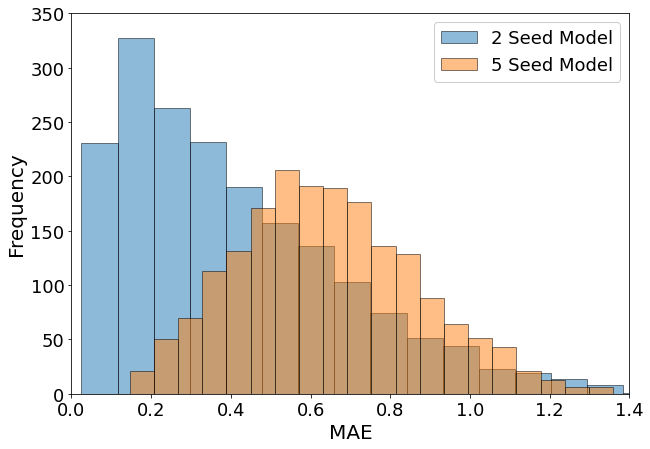

In [ ]:
# Histogram for MAE

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '2 Seed Model')
plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '5 Seed Model')
# plt.hist(mae_pred_4seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '4 Seed Model')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,350,8)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 1.4])
# plt.ylim([0.0, 60])

plt.show()

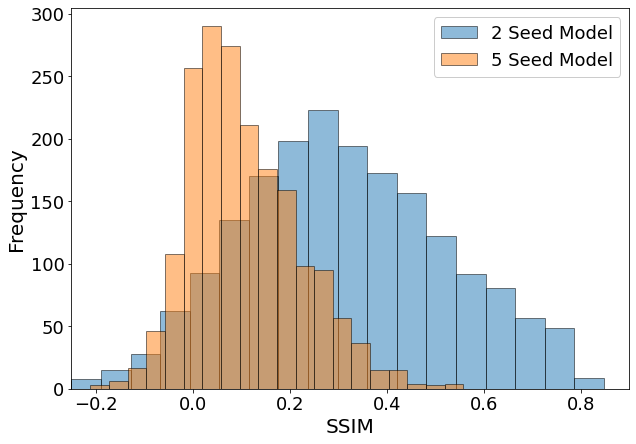

In [ ]:
# Histogram for SSIM

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '2 Seed Model')
plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '5 Seed Model')
# plt.hist(ssim_2trans_score_4seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '4 Seed Model')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,300,7)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([-0.25, 0.9])
# plt.ylim([0.0, 60])

plt.show()

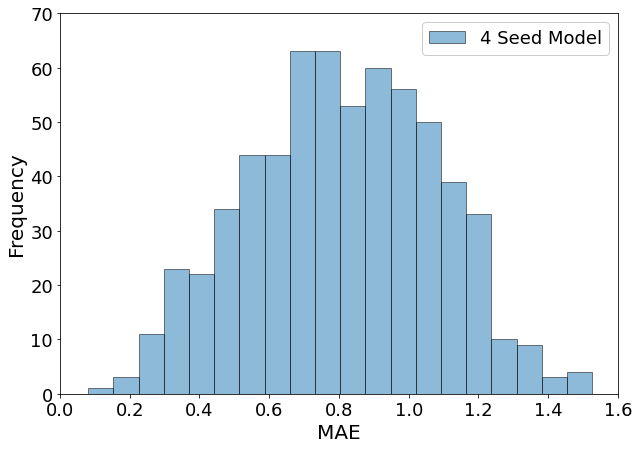

In [ ]:
# Histogram for MAE

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '2 Seed Model')
# plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '5 Seed Model')
plt.hist(mae_pred_4seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '4 Seed Model')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,70,8)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 1.6])
# plt.ylim([0.0, 60])

plt.show()

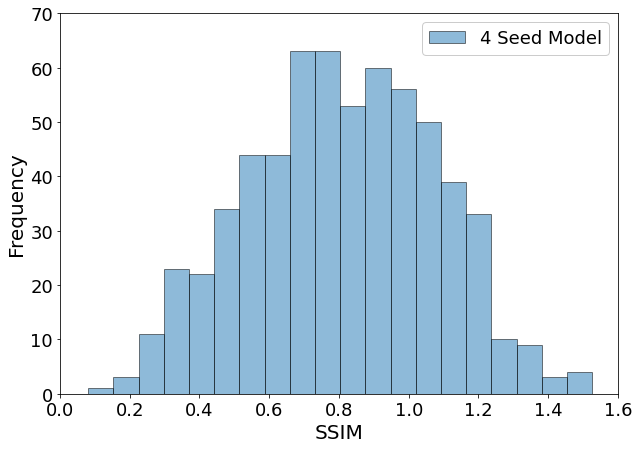

In [ ]:
# Histogram for SSIM

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '2 Seed Model')
# plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '5 Seed Model')
plt.hist(ssim_2trans_score_4seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = '4 Seed Model')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,70,8)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 1.6])
# plt.ylim([0.0, 60])

plt.show()

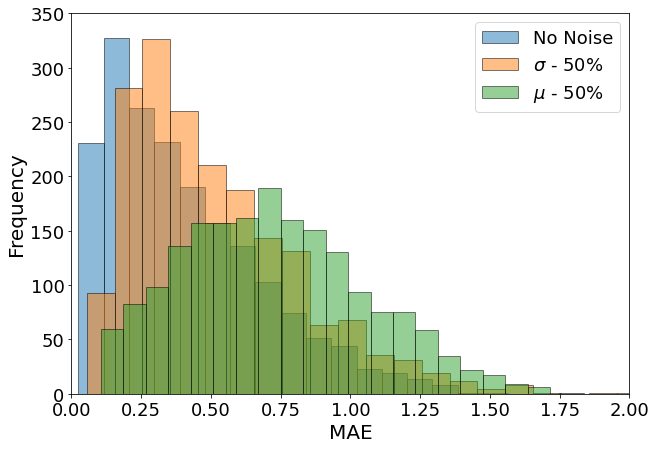

In [ ]:
# Histogram for MAE for 2 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(mae_pred_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
plt.hist(mae_pred_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
# plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'25% $\sigma$ Noise - 5 Seed Model')
# plt.hist(mae_pred_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'50% $\sigma$ Noise - 5 Seed Model')
# plt.hist(mae_pred_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'75% $\sigma$ Noise - 5 Seed Model')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
# plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
y = np.linspace(0,350,8)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 2])
# plt.ylim([0.0, 60])

plt.show()

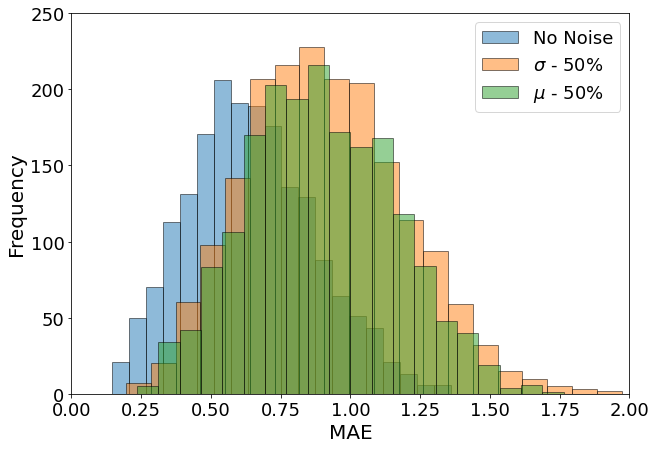

In [ ]:
# Histogram for MAE for 5 seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
# plt.hist(mae_pred_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
# plt.hist(mae_pred_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(mae_pred_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
plt.hist(mae_pred_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
# plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
y = np.linspace(0,250,6)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 2])
# plt.ylim([0.0, 60])

plt.show()

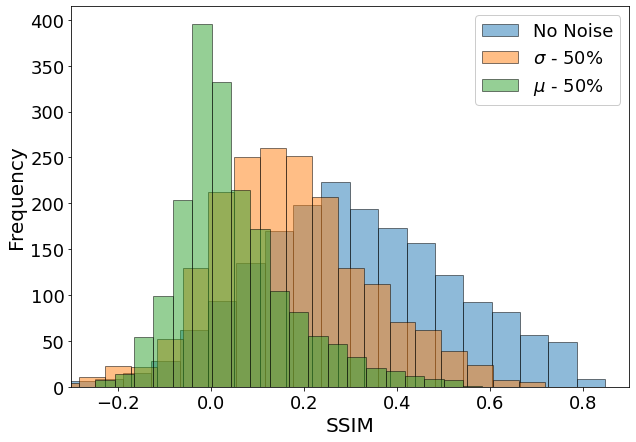

In [ ]:
# Histogram for SSIM for 2 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(ssim_2trans_score_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
plt.hist(ssim_2trans_score_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
# plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'25% $\sigma$ Noise - 5 Seed Model')
# plt.hist(ssim_2trans_score_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'50% $\sigma$ Noise - 5 Seed Model')
# plt.hist(ssim_2trans_score_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'75% $\sigma$ Noise - 5 Seed Model')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,400,9)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([-0.3, 0.9])
# plt.ylim([0.0, 60])

plt.show()

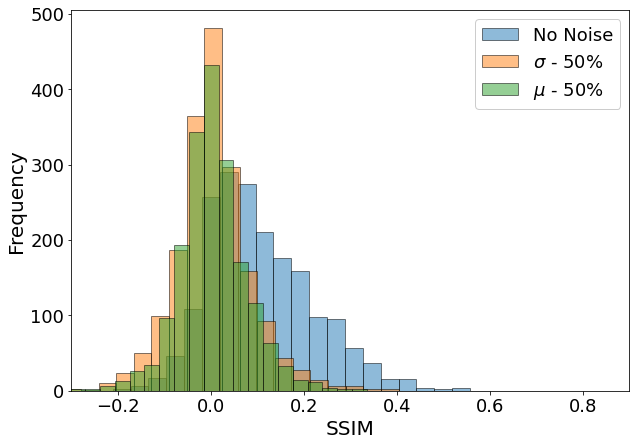

In [ ]:
# Histogram for SSIM for 5 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
# plt.hist(ssim_2trans_score_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
# plt.hist(ssim_2trans_score_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(ssim_2trans_score_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
plt.hist(ssim_2trans_score_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,500,6)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([-0.3, 0.9])
# plt.ylim([0.0, 60])

plt.show()

# Load Evaluation Data

In [ ]:
# Load MAE and SSIM noise data 2 seed

mae_pred_2seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_2seed.txt')
mse_2trans_score_2seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_2seed.txt') 
ssim_2trans_score_2seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_2seed.txt')
loc_2trans2_2seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_2seed.txt') 

mae_pred_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_5.txt')
mse_2trans_score_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_5.txt') 
ssim_2trans_score_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_5.txt')
loc_2trans2_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_5.txt') 
mae_pred_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_5.txt')
mse_2trans_score_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_5.txt') 
ssim_2trans_score_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_5.txt')
loc_2trans2_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_5.txt') 

mae_pred_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_10.txt')
mse_2trans_score_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_10.txt') 
ssim_2trans_score_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_10.txt')
loc_2trans2_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_10.txt') 
mae_pred_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_10.txt')
mse_2trans_score_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_10.txt') 
ssim_2trans_score_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_10.txt')
loc_2trans2_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_10.txt') 

mae_pred_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_15.txt')
mse_2trans_score_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_15.txt') 
ssim_2trans_score_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_15.txt')
loc_2trans2_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_15.txt') 
mae_pred_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_15.txt')
mse_2trans_score_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_15.txt') 
ssim_2trans_score_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_15.txt')
loc_2trans2_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_15.txt') 

mae_pred_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_20.txt')
mse_2trans_score_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_20.txt') 
ssim_2trans_score_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_20.txt')
loc_2trans2_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_20.txt') 
mae_pred_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_20.txt')
mse_2trans_score_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_20.txt') 
ssim_2trans_score_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_20.txt')
loc_2trans2_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_20.txt') 

mae_pred_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_25.txt')
mse_2trans_score_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_25.txt') 
ssim_2trans_score_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_25.txt')
loc_2trans2_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_25.txt') 
mae_pred_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_25.txt')
mse_2trans_score_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_25.txt') 
ssim_2trans_score_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_25.txt')
loc_2trans2_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_25.txt') 

mae_pred_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_30.txt')
mse_2trans_score_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_30.txt') 
ssim_2trans_score_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_30.txt')
loc_2trans2_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_30.txt') 
mae_pred_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_30.txt')
mse_2trans_score_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_30.txt') 
ssim_2trans_score_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_30.txt')
loc_2trans2_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_30.txt') 

mae_pred_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_35.txt')
mse_2trans_score_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_35.txt') 
ssim_2trans_score_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_35.txt')
loc_2trans2_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_35.txt') 
mae_pred_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_35.txt')
mse_2trans_score_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_35.txt') 
ssim_2trans_score_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_35.txt')
loc_2trans2_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_35.txt') 

mae_pred_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_40.txt')
mse_2trans_score_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_40.txt') 
ssim_2trans_score_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_40.txt')
loc_2trans2_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_40.txt') 
mae_pred_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_40.txt')
mse_2trans_score_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_40.txt') 
ssim_2trans_score_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_40.txt')
loc_2trans2_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_40.txt') 

mae_pred_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_45.txt')
mse_2trans_score_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_45.txt') 
ssim_2trans_score_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_45.txt')
loc_2trans2_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_45.txt') 
mae_pred_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_45.txt')
mse_2trans_score_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_45.txt') 
ssim_2trans_score_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_45.txt')
loc_2trans2_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_45.txt') 

mae_pred_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_50.txt')
mse_2trans_score_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_50.txt') 
ssim_2trans_score_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_50.txt')
loc_2trans2_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_50.txt') 
mae_pred_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_50.txt')
mse_2trans_score_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_50.txt') 
ssim_2trans_score_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_50.txt')
loc_2trans2_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_50.txt') 

mae_pred_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_55.txt')
mse_2trans_score_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_55.txt') 
ssim_2trans_score_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_55.txt')
loc_2trans2_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_55.txt') 
mae_pred_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_55.txt')
mse_2trans_score_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_55.txt') 
ssim_2trans_score_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_55.txt')
loc_2trans2_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_55.txt') 

mae_pred_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_60.txt')
mse_2trans_score_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_60.txt') 
ssim_2trans_score_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_60.txt')
loc_2trans2_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_60.txt') 
mae_pred_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_60.txt')
mse_2trans_score_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_60.txt') 
ssim_2trans_score_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_60.txt')
loc_2trans2_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_60.txt') 

mae_pred_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_65.txt')
mse_2trans_score_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_65.txt') 
ssim_2trans_score_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_65.txt')
loc_2trans2_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_65.txt') 
mae_pred_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_65.txt')
mse_2trans_score_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_65.txt') 
ssim_2trans_score_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_65.txt')
loc_2trans2_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_65.txt') 

mae_pred_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_70.txt')
mse_2trans_score_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_70.txt') 
ssim_2trans_score_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_70.txt')
loc_2trans2_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_70.txt') 
mae_pred_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_70.txt')
mse_2trans_score_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_70.txt') 
ssim_2trans_score_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_70.txt')
loc_2trans2_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_70.txt') 

mae_pred_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_75.txt')
mse_2trans_score_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_75.txt') 
ssim_2trans_score_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_75.txt')
loc_2trans2_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_75.txt') 
mae_pred_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_75.txt')
mse_2trans_score_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_75.txt') 
ssim_2trans_score_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_75.txt')
loc_2trans2_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_75.txt') 

mae_pred_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_80.txt')
mse_2trans_score_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_80.txt') 
ssim_2trans_score_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_80.txt')
loc_2trans2_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_80.txt') 
mae_pred_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_80.txt')
mse_2trans_score_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_80.txt') 
ssim_2trans_score_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_80.txt')
loc_2trans2_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_80.txt') 

mae_pred_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_85.txt')
mse_2trans_score_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_85.txt') 
ssim_2trans_score_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_85.txt')
loc_2trans2_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_85.txt') 
mae_pred_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_85.txt')
mse_2trans_score_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_85.txt') 
ssim_2trans_score_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_85.txt')
loc_2trans2_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_85.txt') 

mae_pred_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_90.txt')
mse_2trans_score_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_90.txt') 
ssim_2trans_score_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_90.txt')
loc_2trans2_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_90.txt') 
mae_pred_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_90.txt')
mse_2trans_score_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_90.txt') 
ssim_2trans_score_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_90.txt')
loc_2trans2_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_90.txt') 

mae_pred_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_95.txt')
mse_2trans_score_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_95.txt') 
ssim_2trans_score_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_95.txt')
loc_2trans2_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_95.txt') 
mae_pred_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_95.txt')
mse_2trans_score_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_95.txt') 
ssim_2trans_score_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_95.txt')
loc_2trans2_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_95.txt') 

mae_pred_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_mul_100.txt')
mse_2trans_score_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_mul_100.txt') 
ssim_2trans_score_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_mul_100.txt')
loc_2trans2_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_mul_100.txt') 
mae_pred_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mae_pred_add_100.txt')
mse_2trans_score_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/mse_2trans_score_add_100.txt') 
ssim_2trans_score_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/ssim_2trans_score_add_100.txt')
loc_2trans2_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/2seed/loc_2trans2_add_100.txt') 

In [ ]:
# Load MAE and SSIM noise data 5 seed

mae_pred_4seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mae_pred_4seed.txt')
mse_2trans_score_4seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/mse_2trans_score_4seed.txt') 
ssim_2trans_score_4seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/ssim_2trans_score_4seed.txt')
loc_2trans2_4seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/loc_2trans2_4seed.txt') 

mae_pred_5seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_5seed.txt')
mse_2trans_score_5seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_5seed.txt') 
ssim_2trans_score_5seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_5seed.txt')
loc_2trans2_5seed = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_5seed.txt') 

mae_pred_5seed_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_5.txt')
mse_2trans_score_5seed_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_5.txt') 
ssim_2trans_score_5seed_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_5.txt')
loc_2trans2_5seed_mul_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_5.txt') 
mae_pred_5seed_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_5.txt')
mse_2trans_score_5seed_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_5.txt') 
ssim_2trans_score_5seed_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_5.txt')
loc_2trans2_5seed_add_5 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_5.txt') 

mae_pred_5seed_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_10.txt')
mse_2trans_score_5seed_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_10.txt') 
ssim_2trans_score_5seed_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_10.txt')
loc_2trans2_5seed_mul_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_10.txt') 
mae_pred_5seed_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_10.txt')
mse_2trans_score_5seed_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_10.txt') 
ssim_2trans_score_5seed_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_10.txt')
loc_2trans2_5seed_add_10 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_10.txt') 

mae_pred_5seed_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_15.txt')
mse_2trans_score_5seed_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_15.txt') 
ssim_2trans_score_5seed_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_15.txt')
loc_2trans2_5seed_mul_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_15.txt') 
mae_pred_5seed_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_15.txt')
mse_2trans_score_5seed_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_15.txt') 
ssim_2trans_score_5seed_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_15.txt')
loc_2trans2_5seed_add_15 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_15.txt') 

mae_pred_5seed_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_20.txt')
mse_2trans_score_5seed_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_20.txt') 
ssim_2trans_score_5seed_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_20.txt')
loc_2trans2_5seed_mul_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_20.txt') 
mae_pred_5seed_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_20.txt')
mse_2trans_score_5seed_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_20.txt') 
ssim_2trans_score_5seed_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_20.txt')
loc_2trans2_5seed_add_20 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_20.txt') 

mae_pred_5seed_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_25.txt')
mse_2trans_score_5seed_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_25.txt') 
ssim_2trans_score_5seed_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_25.txt')
loc_2trans2_5seed_mul_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_25.txt') 
mae_pred_5seed_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_25.txt')
mse_2trans_score_5seed_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_25.txt') 
ssim_2trans_score_5seed_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_25.txt')
loc_2trans2_5seed_add_25 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_25.txt') 

mae_pred_5seed_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_30.txt')
mse_2trans_score_5seed_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_30.txt') 
ssim_2trans_score_5seed_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_30.txt')
loc_2trans2_5seed_mul_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_30.txt') 
mae_pred_5seed_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_30.txt')
mse_2trans_score_5seed_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_30.txt') 
ssim_2trans_score_5seed_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_30.txt')
loc_2trans2_5seed_add_30 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_30.txt') 

mae_pred_5seed_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_35.txt')
mse_2trans_score_5seed_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_35.txt') 
ssim_2trans_score_5seed_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_35.txt')
loc_2trans2_5seed_mul_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_35.txt') 
mae_pred_5seed_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_35.txt')
mse_2trans_score_5seed_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_35.txt') 
ssim_2trans_score_5seed_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_35.txt')
loc_2trans2_5seed_add_35 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_35.txt') 

mae_pred_5seed_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_40.txt')
mse_2trans_score_5seed_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_40.txt') 
ssim_2trans_score_5seed_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_40.txt')
loc_2trans2_5seed_mul_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_40.txt') 
mae_pred_5seed_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_40.txt')
mse_2trans_score_5seed_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_40.txt') 
ssim_2trans_score_5seed_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_40.txt')
loc_2trans2_5seed_add_40 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_40.txt') 

mae_pred_5seed_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_45.txt')
mse_2trans_score_5seed_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_45.txt') 
ssim_2trans_score_5seed_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_45.txt')
loc_2trans2_5seed_mul_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_45.txt') 
mae_pred_5seed_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_45.txt')
mse_2trans_score_5seed_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_45.txt') 
ssim_2trans_score_5seed_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_45.txt')
loc_2trans2_5seed_add_45 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_45.txt') 

mae_pred_5seed_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_50.txt')
mse_2trans_score_5seed_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_50.txt') 
ssim_2trans_score_5seed_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_50.txt')
loc_2trans2_5seed_mul_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_50.txt') 
mae_pred_5seed_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_50.txt')
mse_2trans_score_5seed_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_50.txt') 
ssim_2trans_score_5seed_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_50.txt')
loc_2trans2_5seed_add_50 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_50.txt') 

mae_pred_5seed_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_55.txt')
mse_2trans_score_5seed_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_55.txt') 
ssim_2trans_score_5seed_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_55.txt')
loc_2trans2_5seed_mul_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_55.txt') 
mae_pred_5seed_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_55.txt')
mse_2trans_score_5seed_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_55.txt') 
ssim_2trans_score_5seed_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_55.txt')
loc_2trans2_5seed_add_55 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_55.txt') 

mae_pred_5seed_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_60.txt')
mse_2trans_score_5seed_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_60.txt') 
ssim_2trans_score_5seed_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_60.txt')
loc_2trans2_5seed_mul_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_60.txt') 
mae_pred_5seed_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_60.txt')
mse_2trans_score_5seed_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_60.txt') 
ssim_2trans_score_5seed_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_60.txt')
loc_2trans2_5seed_add_60 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_60.txt') 

mae_pred_5seed_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_65.txt')
mse_2trans_score_5seed_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_65.txt') 
ssim_2trans_score_5seed_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_65.txt')
loc_2trans2_5seed_mul_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_65.txt') 
mae_pred_5seed_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_65.txt')
mse_2trans_score_5seed_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_65.txt') 
ssim_2trans_score_5seed_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_65.txt')
loc_2trans2_5seed_add_65 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_65.txt') 

mae_pred_5seed_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_70.txt')
mse_2trans_score_5seed_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_70.txt') 
ssim_2trans_score_5seed_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_70.txt')
loc_2trans2_5seed_mul_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_70.txt') 
mae_pred_5seed_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_70.txt')
mse_2trans_score_5seed_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_70.txt') 
ssim_2trans_score_5seed_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_70.txt')
loc_2trans2_5seed_add_70 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_70.txt') 

mae_pred_5seed_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_75.txt')
mse_2trans_score_5seed_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_75.txt') 
ssim_2trans_score_5seed_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_75.txt')
loc_2trans2_5seed_mul_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_75.txt') 
mae_pred_5seed_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_75.txt')
mse_2trans_score_5seed_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_75.txt') 
ssim_2trans_score_5seed_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_75.txt')
loc_2trans2_5seed_add_75 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_75.txt') 

mae_pred_5seed_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_80.txt')
mse_2trans_score_5seed_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_80.txt') 
ssim_2trans_score_5seed_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_80.txt')
loc_2trans2_5seed_mul_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_80.txt') 
mae_pred_5seed_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_80.txt')
mse_2trans_score_5seed_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_80.txt') 
ssim_2trans_score_5seed_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_80.txt')
loc_2trans2_5seed_add_80 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_80.txt') 

mae_pred_5seed_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_85.txt')
mse_2trans_score_5seed_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_85.txt') 
ssim_2trans_score_5seed_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_85.txt')
loc_2trans2_5seed_mul_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_85.txt') 
mae_pred_5seed_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_85.txt')
mse_2trans_score_5seed_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_85.txt') 
ssim_2trans_score_5seed_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_85.txt')
loc_2trans2_5seed_add_85 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_85.txt') 

mae_pred_5seed_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_90.txt')
mse_2trans_score_5seed_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_90.txt') 
ssim_2trans_score_5seed_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_90.txt')
loc_2trans2_5seed_mul_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_90.txt') 
mae_pred_5seed_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_90.txt')
mse_2trans_score_5seed_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_90.txt') 
ssim_2trans_score_5seed_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_90.txt')
loc_2trans2_5seed_add_90 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_90.txt') 

mae_pred_5seed_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_95.txt')
mse_2trans_score_5seed_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_95.txt') 
ssim_2trans_score_5seed_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_95.txt')
loc_2trans2_5seed_mul_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_95.txt') 
mae_pred_5seed_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_95.txt')
mse_2trans_score_5seed_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_95.txt') 
ssim_2trans_score_5seed_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_95.txt')
loc_2trans2_5seed_add_95 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_95.txt') 

mae_pred_5seed_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_mul_100.txt')
mse_2trans_score_5seed_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_mul_100.txt') 
ssim_2trans_score_5seed_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_mul_100.txt')
loc_2trans2_5seed_mul_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_mul_100.txt') 
mae_pred_5seed_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mae_pred_add_100.txt')
mse_2trans_score_5seed_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/mse_2trans_score_add_100.txt') 
ssim_2trans_score_5seed_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/ssim_2trans_score_add_100.txt')
loc_2trans2_5seed_add_100 = np.load('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Model/5seed/loc_2trans2_add_100.txt') 

# Figures

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.


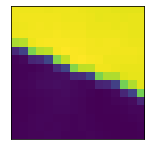

In [ ]:
# 2 Seed

plt.figure(figsize=(10,23))

# 26 original fig
# 102 second fig
# APP 2, 31, 47, 49, 50
# APP 62,64,75,97,135
xInd=135

f_size=18

mod_true = np.reshape(output_2trans_test[xInd,:],[16,16]) # CHECK FOR TRAIN OR TEST

mod_pred_2trans = np.reshape(trans_2[:,xInd, loc_2trans2[0,xInd] ,0],[16,16]) # Shows most similar prediction
pred_mae = mean_absolute_error(mod_true, mod_pred_2trans)
pred_ssim = ssim(mod_true, mod_pred_2trans)
filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
filter_mae = mean_absolute_error(mod_true, filter_pred)
filter_ssim = ssim(mod_true, filter_pred)

plt.subplot(711)
plt.imshow(mod_true)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
# plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_mae:0.2f}',fontsize=f_size)

# Original Prediction
# plt.subplot(712)
# plt.imshow(filter_pred)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_ssim:0.2f}',fontsize=f_size)

plt.subplots_adjust(hspace=0.4)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:39: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:44: UserWarning: Inputs

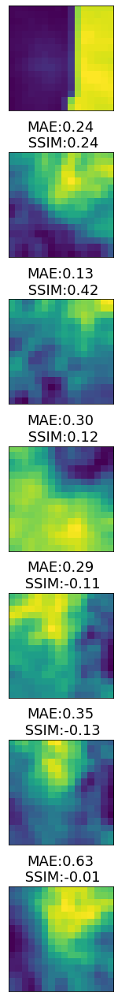

In [ ]:
# 2 Seed

plt.figure(figsize=(10,23))

# 26 original fig
# 102 second fig
# APP 2, 31, 47, 49, 50
xInd=51

f_size=18

mod_true = np.reshape(output_2trans_test[xInd,:],[16,16]) # CHECK FOR TRAIN OR TEST

mod_pred_2trans = np.reshape(trans_2[:,xInd, loc_2trans2[0,xInd] ,0],[16,16]) # Shows most similar prediction
pred_mae = mean_absolute_error(mod_true, mod_pred_2trans)
pred_ssim = ssim(mod_true, mod_pred_2trans)
filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
filter_mae = mean_absolute_error(mod_true, filter_pred)
filter_ssim = ssim(mod_true, filter_pred)

mul_img_25 = np.reshape(trans_2_mul_25[:,xInd, loc_2trans2_mul_25[0,xInd] ,0],[16,16]) # Shows most similar prediction
mul_avg_25 = cv2.GaussianBlur(mul_img_25,(3,3),0) # Gaussian smoothing
mul_mae_25 = mean_absolute_error(mod_true, mul_avg_25)
mul_ssim_25 = ssim(mod_true, mul_avg_25)

add_img_25 = np.reshape(trans_2_add_25[:,xInd, loc_2trans2_add_25[0,xInd] ,0],[16,16]) # Shows most similar prediction
add_avg_25 = cv2.GaussianBlur(add_img_25,(3,3),0) # Gaussian smoothing
add_mae_25 = mean_absolute_error(mod_true, add_avg_25)
add_ssim_25 = ssim(mod_true, add_avg_25)

mul_img_50 = np.reshape(trans_2_mul_50[:,xInd, loc_2trans2_mul_50[0,xInd] ,0],[16,16]) # Shows most similar prediction
mul_avg_50 = cv2.GaussianBlur(mul_img_50,(3,3),0) # Gaussian smoothing
mul_mae_50 = mean_absolute_error(mod_true, mul_avg_50)
mul_ssim_50 = ssim(mod_true, mul_avg_50)

add_img_50 = np.reshape(trans_2_add_50[:,xInd, loc_2trans2_add_50[0,xInd] ,0],[16,16]) # Shows most similar prediction
add_avg_50 = cv2.GaussianBlur(add_img_50,(3,3),0) # Gaussian smoothing
add_mae_50 = mean_absolute_error(mod_true, add_avg_50)
add_ssim_50 = ssim(mod_true, add_avg_50)

mul_img_75 = np.reshape(trans_2_mul_75[:,xInd, loc_2trans2_mul_75[0,xInd] ,0],[16,16]) # Shows most similar prediction
mul_avg_75 = cv2.GaussianBlur(mul_img_75,(3,3),0) # Gaussian smoothing
mul_mae_75 = mean_absolute_error(mod_true, mul_avg_75)
mul_ssim_75 = ssim(mod_true, mul_avg_75)

add_img_75 = np.reshape(trans_2_add_75[:,xInd, loc_2trans2_add_75[0,xInd] ,0],[16,16]) # Shows most similar prediction
add_avg_75 = cv2.GaussianBlur(add_img_75,(3,3),0) # Gaussian smoothing
add_mae_75 = mean_absolute_error(mod_true, add_avg_75)
add_ssim_75 = ssim(mod_true, add_avg_75)

mul_img_100 = np.reshape(trans_2_mul_100[:,xInd, loc_2trans2_mul_100[0,xInd] ,0],[16,16]) # Shows most similar prediction
mul_avg_100 = cv2.GaussianBlur(mul_img_100,(3,3),0) # Gaussian smoothing
mul_mae_100 = mean_absolute_error(mod_true, mul_avg_100)
mul_ssim_100 = ssim(mod_true, mul_avg_100)

add_img_100 = np.reshape(trans_2_add_100[:,xInd, loc_2trans2_add_100[0,xInd] ,0],[16,16]) # Shows most similar prediction
add_avg_100 = cv2.GaussianBlur(add_img_100,(3,3),0) # Gaussian smoothing
add_mae_100 = mean_absolute_error(mod_true, add_avg_100)
add_ssim_100 = ssim(mod_true, add_avg_100)

# Original Prediction
# plt.subplot(711)
# plt.imshow(filter_pred)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_ssim:0.2f}',fontsize=f_size)

plt.subplot(711)
plt.imshow(mod_true)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
# plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_mae:0.2f}',fontsize=f_size)

plt.subplot(712)
plt.imshow(mul_avg_25)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
plt.title(f'MAE:{mul_mae_25:0.2f}\n SSIM:{mul_ssim_25:0.2f}',fontsize=f_size)

plt.subplot(713)
plt.imshow(mul_avg_50)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
plt.title(f'MAE:{mul_mae_50:0.2f}\n SSIM:{mul_ssim_50:0.2f}',fontsize=f_size)

plt.subplot(714)
plt.imshow(mul_avg_75)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
plt.title(f'MAE:{mul_mae_75:0.2f}\n SSIM:{mul_ssim_75:0.2f}',fontsize=f_size)

plt.subplot(715)
plt.imshow(add_avg_25)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
plt.title(f'MAE:{add_mae_25:0.2f}\n SSIM:{add_ssim_25:0.2f}',fontsize=f_size)

plt.subplot(716)
plt.imshow(add_avg_50)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
plt.title(f'MAE:{add_mae_50:0.2f}\n SSIM:{add_ssim_50:0.2f}',fontsize=f_size)

plt.subplot(717)
plt.imshow(add_avg_75)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
plt.title(f'MAE:{add_mae_75:0.2f}\n SSIM:{add_ssim_75:0.2f}',fontsize=f_size)

plt.subplots_adjust(hspace=0.4)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.


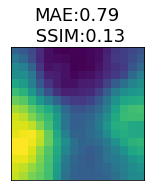

In [ ]:
# 5 Seed

plt.figure(figsize=(10,23))

# 30 original fig
# 82 second fig
# APP 27, 47, 50, 52, 53
# APP 33, 55, 71, 74, 81
xInd=81

f_size=18

mod_true = np.reshape(output_2trans_test[xInd,:],[16,16]) # CHECK FOR TRAIN OR TEST

mod_pred_2trans = np.reshape(trans_2[:,xInd, loc_2trans2[0,xInd] ,0],[16,16]) # Shows most similar prediction
pred_mae = mean_absolute_error(mod_true, mod_pred_2trans)
pred_ssim = ssim(mod_true, mod_pred_2trans)
filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
filter_mae = mean_absolute_error(mod_true, filter_pred)
filter_ssim = ssim(mod_true, filter_pred)

# plt.subplot(711)
# plt.imshow(mod_true)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# # plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_mae:0.2f}',fontsize=f_size)

# # Original Prediction
plt.subplot(712)
plt.imshow(filter_pred)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_ssim:0.2f}',fontsize=f_size)

plt.subplots_adjust(hspace=0.4)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:25: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:30: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:40: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:45: UserWarning: Inputs have mismatched dtype.  Set

Text(0.5, 1.0, 'MAE:1.14\n SSIM:0.17')

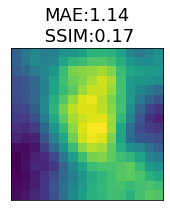

In [ ]:
# 5 Seed

plt.figure(figsize=(10,23))

# 30 original fig
# 82 second fig
# APP 27, 47, 50, 52, 53
# APP 33, 55, 71, 74, 81
xInd=81

f_size=18

mod_true = np.reshape(output_2trans_test[xInd,:],[16,16]) # CHECK FOR TRAIN OR TEST

mod_pred_2trans = np.reshape(trans_2[:,xInd, loc_2trans2[0,xInd] ,0],[16,16]) # Shows most similar prediction
pred_mae = mean_absolute_error(mod_true, mod_pred_2trans)
pred_ssim = ssim(mod_true, mod_pred_2trans)
filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
filter_mae = mean_absolute_error(mod_true, filter_pred)
filter_ssim = ssim(mod_true, filter_pred)

mul_img_25 = np.reshape(trans_2_mul_25[:,xInd, loc_2trans2_mul_25[0,xInd] ,0],[16,16]) # Shows most similar prediction
mul_avg_25 = cv2.GaussianBlur(mul_img_25,(3,3),0) # Gaussian smoothing
mul_mae_25 = mean_absolute_error(mod_true, mul_avg_25)
mul_ssim_25 = ssim(mod_true, mul_avg_25)

add_img_25 = np.reshape(trans_2_add_25[:,xInd, loc_2trans2_add_25[0,xInd] ,0],[16,16]) # Shows most similar prediction
add_avg_25 = cv2.GaussianBlur(add_img_25,(3,3),0) # Gaussian smoothing
add_mae_25 = mean_absolute_error(mod_true, add_avg_25)
add_ssim_25 = ssim(mod_true, add_avg_25)

mul_img_50 = np.reshape(trans_2_mul_50[:,xInd, loc_2trans2_mul_50[0,xInd] ,0],[16,16]) # Shows most similar prediction
mul_avg_50 = cv2.GaussianBlur(mul_img_50,(3,3),0) # Gaussian smoothing
mul_mae_50 = mean_absolute_error(mod_true, mul_avg_50)
mul_ssim_50 = ssim(mod_true, mul_avg_50)

add_img_50 = np.reshape(trans_2_add_50[:,xInd, loc_2trans2_add_50[0,xInd] ,0],[16,16]) # Shows most similar prediction
add_avg_50 = cv2.GaussianBlur(add_img_50,(3,3),0) # Gaussian smoothing
add_mae_50 = mean_absolute_error(mod_true, add_avg_50)
add_ssim_50 = ssim(mod_true, add_avg_50)

mul_img_75 = np.reshape(trans_2_mul_75[:,xInd, loc_2trans2_mul_75[0,xInd] ,0],[16,16]) # Shows most similar prediction
mul_avg_75 = cv2.GaussianBlur(mul_img_75,(3,3),0) # Gaussian smoothing
mul_mae_75 = mean_absolute_error(mod_true, mul_avg_75)
mul_ssim_75 = ssim(mod_true, mul_avg_75)

add_img_75 = np.reshape(trans_2_add_75[:,xInd, loc_2trans2_add_75[0,xInd] ,0],[16,16]) # Shows most similar prediction
add_avg_75 = cv2.GaussianBlur(add_img_75,(3,3),0) # Gaussian smoothing
add_mae_75 = mean_absolute_error(mod_true, add_avg_75)
add_ssim_75 = ssim(mod_true, add_avg_75)

mul_img_100 = np.reshape(trans_2_mul_100[:,xInd, loc_2trans2_mul_100[0,xInd] ,0],[16,16]) # Shows most similar prediction
mul_avg_100 = cv2.GaussianBlur(mul_img_100,(3,3),0) # Gaussian smoothing
mul_mae_100 = mean_absolute_error(mod_true, mul_avg_100)
mul_ssim_100 = ssim(mod_true, mul_avg_100)

add_img_100 = np.reshape(trans_2_add_100[:,xInd, loc_2trans2_add_100[0,xInd] ,0],[16,16]) # Shows most similar prediction
add_avg_100 = cv2.GaussianBlur(add_img_100,(3,3),0) # Gaussian smoothing
add_mae_100 = mean_absolute_error(mod_true, add_avg_100)
add_ssim_100 = ssim(mod_true, add_avg_100)

# Original Prediction
# plt.subplot(711)
# plt.imshow(filter_pred)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_ssim:0.2f}',fontsize=f_size)

# plt.subplot(711)
# plt.imshow(mod_true)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# # plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_mae:0.2f}',fontsize=f_size)

# plt.subplot(712)
# plt.imshow(mul_avg_25)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# plt.title(f'MAE:{mul_mae_25:0.2f}\n SSIM:{mul_ssim_25:0.2f}',fontsize=f_size)

# plt.subplot(713)
# plt.imshow(mul_avg_50)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# plt.title(f'MAE:{mul_mae_50:0.2f}\n SSIM:{mul_ssim_50:0.2f}',fontsize=f_size)

# plt.subplot(714)
# plt.imshow(mul_avg_75)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# plt.title(f'MAE:{mul_mae_75:0.2f}\n SSIM:{mul_ssim_75:0.2f}',fontsize=f_size)

# plt.subplot(715)
# plt.imshow(add_avg_25)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# plt.title(f'MAE:{add_mae_25:0.2f}\n SSIM:{add_ssim_25:0.2f}',fontsize=f_size)

# plt.subplot(716)
# plt.imshow(add_avg_50)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# plt.title(f'MAE:{add_mae_50:0.2f}\n SSIM:{add_ssim_50:0.2f}',fontsize=f_size)

# plt.subplot(717)
# plt.imshow(add_avg_75)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# plt.title(f'MAE:{add_mae_75:0.2f}\n SSIM:{add_ssim_75:0.2f}',fontsize=f_size)

# plt.subplots_adjust(hspace=0.4)

# Appendix Figures

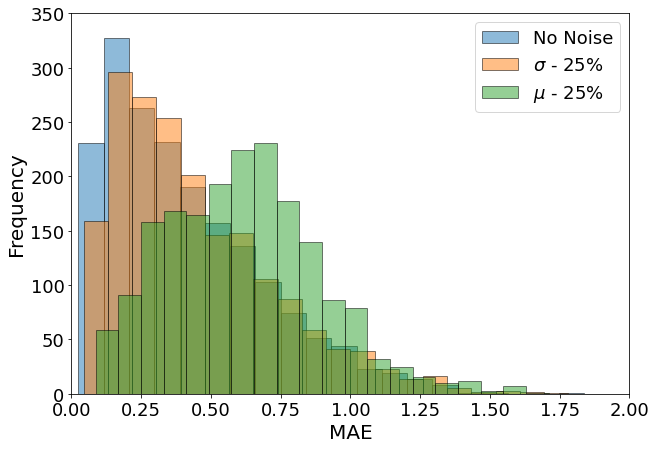

In [ ]:
# Histogram for MAE for 2 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(mae_pred_mul_25, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 25%')
plt.hist(mae_pred_add_25, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 25%')
# plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'25% $\sigma$ Noise - 5 Seed Model')
# plt.hist(mae_pred_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'50% $\sigma$ Noise - 5 Seed Model')
# plt.hist(mae_pred_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'75% $\sigma$ Noise - 5 Seed Model')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
# plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
y = np.linspace(0,350,8)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 2])
# plt.ylim([0.0, 60])

plt.show()

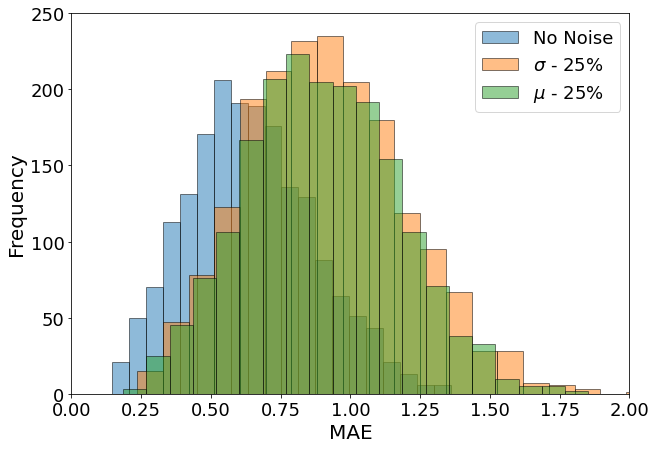

In [ ]:
# Histogram for MAE for 5 seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
# plt.hist(mae_pred_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
# plt.hist(mae_pred_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(mae_pred_5seed_mul_25, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 25%')
plt.hist(mae_pred_5seed_add_25, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 25%')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
# plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
y = np.linspace(0,250,6)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 2])
# plt.ylim([0.0, 60])

plt.show()

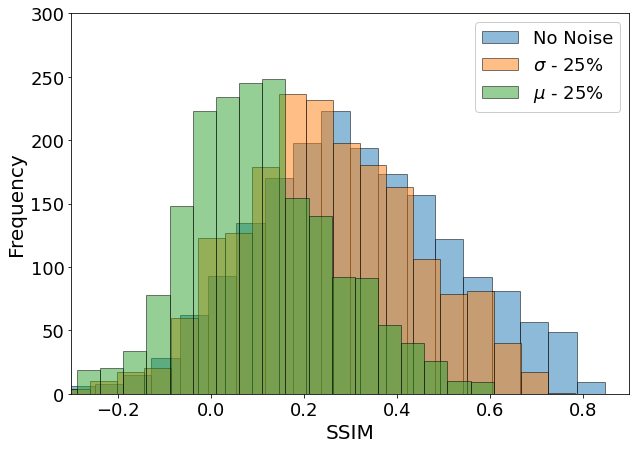

In [ ]:
# Histogram for SSIM for 2 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(ssim_2trans_score_mul_25, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 25%')
plt.hist(ssim_2trans_score_add_25, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 25%')
# plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'25% $\sigma$ Noise - 5 Seed Model')
# plt.hist(ssim_2trans_score_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'50% $\sigma$ Noise - 5 Seed Model')
# plt.hist(ssim_2trans_score_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'75% $\sigma$ Noise - 5 Seed Model')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,300,7)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([-0.3, 0.9])
# plt.ylim([0.0, 60])

plt.show()

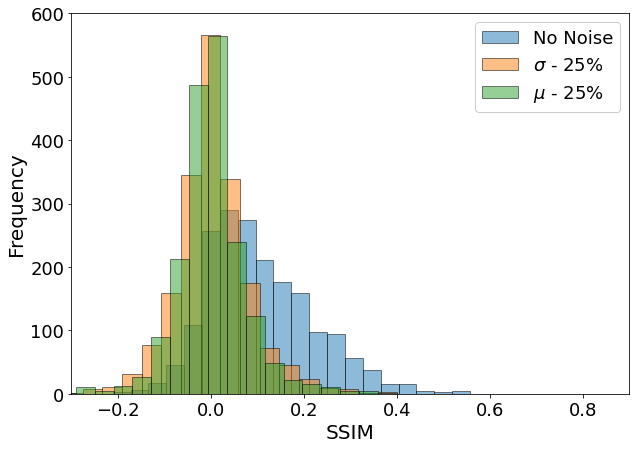

In [ ]:
# Histogram for SSIM for 5 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
# plt.hist(ssim_2trans_score_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
# plt.hist(ssim_2trans_score_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(ssim_2trans_score_5seed_mul_25, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 25%')
plt.hist(ssim_2trans_score_5seed_add_25, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 25%')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,600,7)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([-0.3, 0.9])
# plt.ylim([0.0, 60])

plt.show()

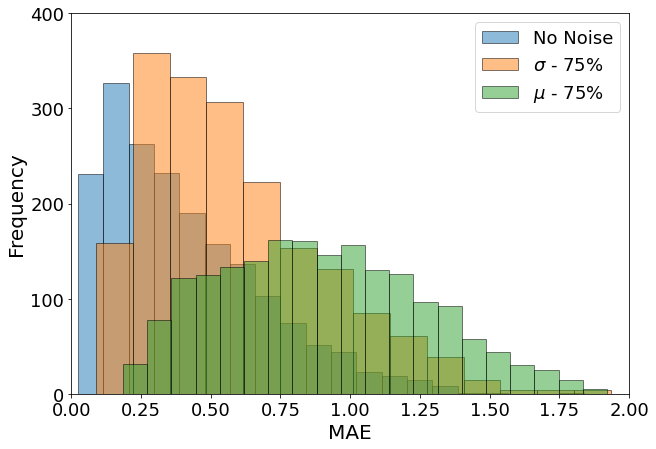

In [ ]:
# Histogram for MAE for 2 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(mae_pred_mul_75, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 75%')
plt.hist(mae_pred_add_75, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 75%')
# plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'25% $\sigma$ Noise - 5 Seed Model')
# plt.hist(mae_pred_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'50% $\sigma$ Noise - 5 Seed Model')
# plt.hist(mae_pred_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'75% $\sigma$ Noise - 5 Seed Model')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
# plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
y = np.linspace(0,400,5)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 2])
# plt.ylim([0.0, 60])

plt.show()

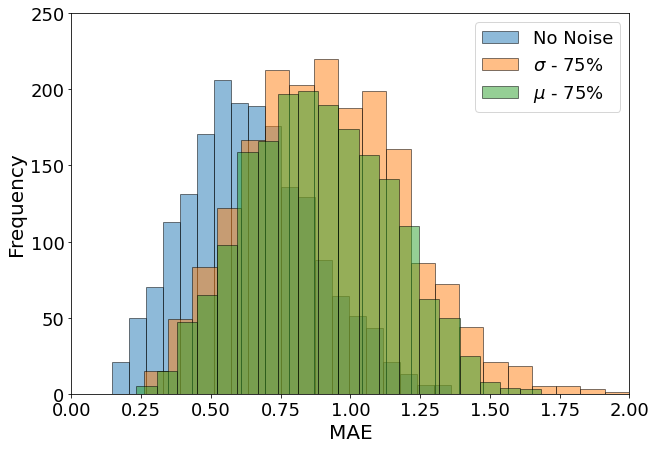

In [ ]:
# Histogram for MAE for 5 seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
# plt.hist(mae_pred_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
# plt.hist(mae_pred_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(mae_pred_5seed_mul_75, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 75%')
plt.hist(mae_pred_5seed_add_75, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 75%')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
# plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
y = np.linspace(0,250,6)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 2])
# plt.ylim([0.0, 60])

plt.show()

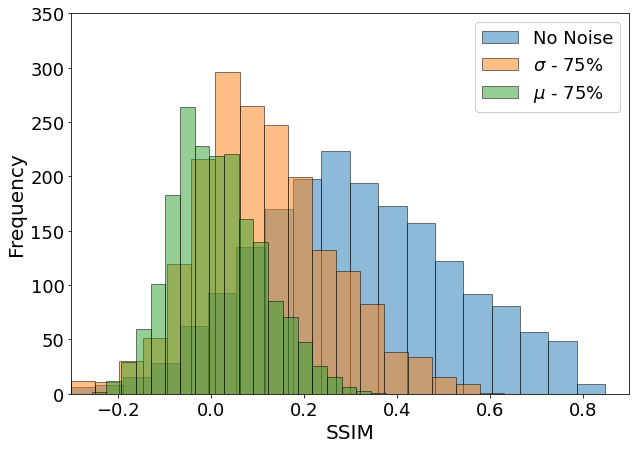

In [ ]:
# Histogram for SSIM for 2 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(ssim_2trans_score_mul_75, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 75%')
plt.hist(ssim_2trans_score_add_75, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 75%')
# plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'25% $\sigma$ Noise - 5 Seed Model')
# plt.hist(ssim_2trans_score_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'50% $\sigma$ Noise - 5 Seed Model')
# plt.hist(ssim_2trans_score_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'75% $\sigma$ Noise - 5 Seed Model')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,350,8)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([-0.3, 0.9])
# plt.ylim([0.0, 60])

plt.show()

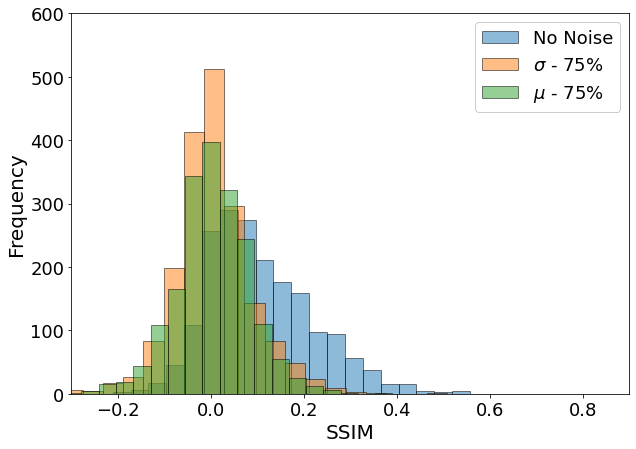

In [ ]:
# Histogram for SSIM for 5 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
# plt.hist(ssim_2trans_score_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
# plt.hist(ssim_2trans_score_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(ssim_2trans_score_5seed_mul_75, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 75%')
plt.hist(ssim_2trans_score_5seed_add_75, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 75%')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,600,7)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([-0.3, 0.9])
# plt.ylim([0.0, 60])

plt.show()

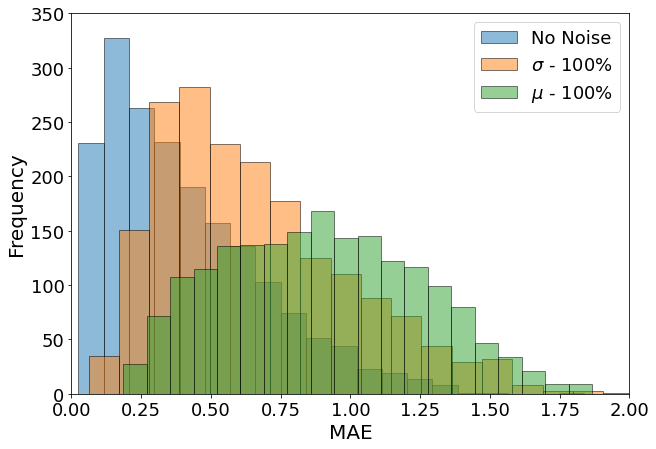

In [ ]:
# Histogram for MAE for 2 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(mae_pred_mul_100, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 100%')
plt.hist(mae_pred_add_100, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 100%')
# plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'25% $\sigma$ Noise - 5 Seed Model')
# plt.hist(mae_pred_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'50% $\sigma$ Noise - 5 Seed Model')
# plt.hist(mae_pred_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'75% $\sigma$ Noise - 5 Seed Model')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
# plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
y = np.linspace(0,350,8)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 2])
# plt.ylim([0.0, 60])

plt.show()

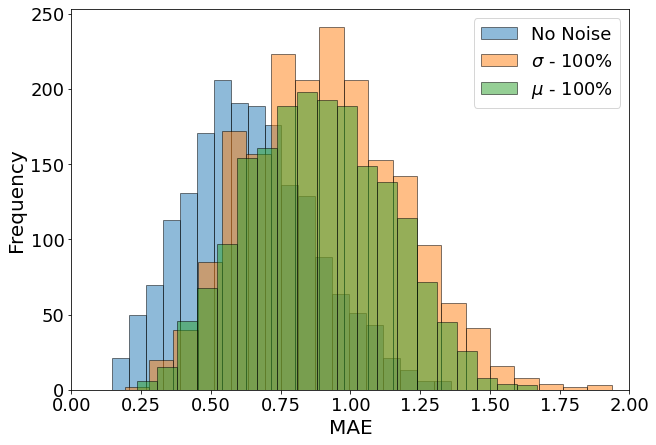

In [ ]:
# Histogram for MAE for 5 seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(mae_pred_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
# plt.hist(mae_pred_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
# plt.hist(mae_pred_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.hist(mae_pred_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(mae_pred_5seed_mul_100, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 100%')
plt.hist(mae_pred_5seed_add_100, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 100%')
plt.xlabel('MAE',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
# plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
plt.legend(fontsize=f_size, loc="upper right")
y = np.linspace(0,250,6)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([0, 2])
# plt.ylim([0.0, 60])

plt.show()

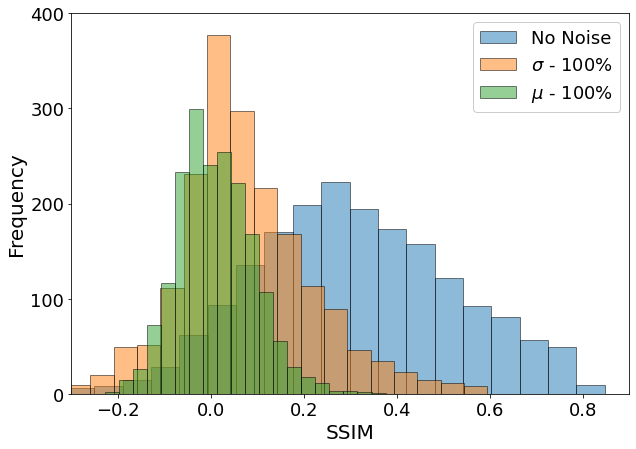

In [ ]:
# Histogram for SSIM for 2 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(ssim_2trans_score_mul_100, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 100%')
plt.hist(ssim_2trans_score_add_100, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 100%')
# plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'25% $\sigma$ Noise - 5 Seed Model')
# plt.hist(ssim_2trans_score_5seed_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'50% $\sigma$ Noise - 5 Seed Model')
# plt.hist(ssim_2trans_score_5seed_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'75% $\sigma$ Noise - 5 Seed Model')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,400,5)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([-0.3, 0.9])
# plt.ylim([0.0, 60])

plt.show()

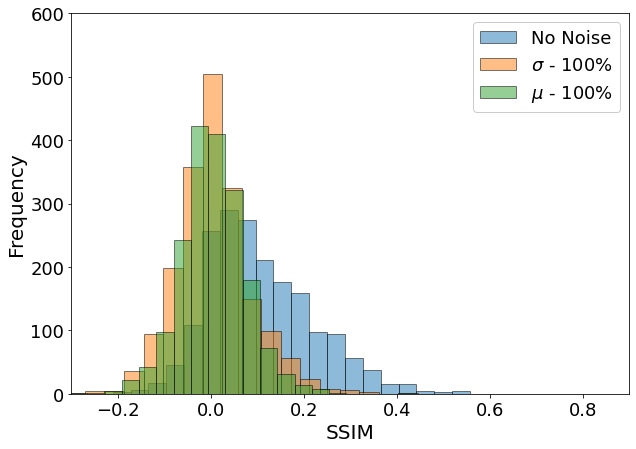

In [ ]:
# Histogram for SSIM for 5 Seed Model

bins = 20
alpha = 0.5
rwidth = 1

f_size = 18

plt.figure(figsize=(10,7))
# plt.hist(ssim_2trans_score_2seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
# plt.hist(ssim_2trans_score_mul_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 50%')
# plt.hist(ssim_2trans_score_add_50, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 50%')
plt.hist(ssim_2trans_score_5seed, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'No Noise')
plt.hist(ssim_2trans_score_5seed_mul_100, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\sigma$ - 100%')
plt.hist(ssim_2trans_score_5seed_add_100, bins, rwidth=rwidth, alpha=alpha, edgecolor='black', label = r'$\mu$ - 100%')
plt.xlabel('SSIM',fontsize=f_size+2)
plt.ylabel('Frequency',fontsize=f_size+2)
#plt.title('Receiver operating characteristic for multi-class data')
plt.legend(loc="upper right", facecolor='white', framealpha=1,fontsize=f_size)
y = np.linspace(0,600,7)
plt.xticks(fontsize=f_size)
plt.yticks(y,fontsize=f_size)
plt.xlim([-0.3, 0.9])
# plt.ylim([0.0, 60])

plt.show()

# 10 Seed Data

In [5]:
input_2trans_mat = loadmat('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Data/input2trans.mat')
input_2trans = input_2trans_mat['input'] # 2 transducer elements on each edge

output_2trans_mat = loadmat('/content/drive/MyDrive/Colab Notebooks/Reconstruction/Data/output2trans.mat')
output_2trans = output_2trans_mat['output'] # 2 transducer elements on each edge
output_2trans = np.rollaxis(output_2trans, 2, 0) # rearranging data for processing

In [ ]:
# Merged image for evaluation

merge_2trans = []
size_i = trans_2.shape[1]
size_n = trans_2.shape[2]

for i in range(size_i):

  xInd = i

  for n in range(size_n):

    merge_2trans.append(np.reshape(trans_2[:,xInd,n,0],[16,16])) # CHANGE TO trans_2_train FOR TRAIN DATA

# Split data to filter sets for each prediction
merge_2trans = np.array_split(merge_2trans, size_i)
merge_2trans = np.array(merge_2trans)
sizeA = merge_2trans.shape[0]
sizeB = merge_2trans.shape[2]
sizeC = merge_2trans.shape[3]
testing = np.zeros((sizeA,sizeB,sizeC))
avg_merge = np.zeros((sizeA,sizeB,sizeC))
pred_mean = np.zeros((sizeA,sizeB,sizeC))
pred_var = np.zeros((sizeA,sizeB,sizeC))
size_j = merge_2trans.shape[2]

for i in range(size_i):

  xInd = i

  for n in range(size_n):
    for j in range(size_j):

      jInd = j

      for k in range(size_j):
        testing[xInd,:,:] =+ merge_2trans[xInd,n,:,:]
        avg_merge[xInd,:,:] = testing[xInd,:,:] / size_n #averaged image

        pred_mean[xInd,jInd,k] = sum(merge_2trans[xInd,:,jInd,k]) / size_n
        pred_var[xInd,jInd,k] = (sum((merge_2trans[xInd,:,jInd,k]) - (pred_mean[xInd,jInd,k])) ** 2) / size_n # calculates variance of all filter outputs
        # pred_var[xInd,jInd,k] = statistics.variance(merge_2trans[xInd,:,jInd,k])

In [ ]:
# MSE and SSIM Evaluation

mse_2trans = []
mod_pred_2trans = []
mse_2trans_score = []
ssim_2trans = []
ssim_2trans2 = []
ssim_2trans_score = []
loc_2trans = []
mae_pred = []
mae_avg = []

size_i = 1250
size_n = trans_2.shape[2]

for i in range(size_i):

  xInd = i
  mod_true = np.reshape(output_2trans_test[xInd,:],[16,16])

  for n in range(size_n):

    mod_pred_2trans.append(np.reshape(trans_2[:,xInd,n,0],[16,16]))

    mse_2trans.append(mean_squared_error(mod_true, mod_pred_2trans[n])) # Compiling list of scores for all predictions and all voronois

    ssim_2trans.append(ssim(mod_true, mod_pred_2trans[n], # Compiling list of scores for all predictions and all voronois
                      data_range=mod_pred_2trans[n].max() - mod_pred_2trans[n].min()))


mse_2trans = np.array_split(mse_2trans, size_i) # Splitting MSE scores into rows for each prediction and columns for each true voronoi
mse_2trans = np.array(mse_2trans)

ssim_2trans = np.array_split(ssim_2trans, size_i) # Splitting SSIM scores into rows for each prediction and columns for each true voronoi
ssim_2trans = np.array(ssim_2trans)


for i in range(size_i):

  mse_2trans_score.append(np.where(mse_2trans[i,:] == np.amin(mse_2trans[i,:]))) # Searches for minimum index of MSE for each prediction
  ssim_2trans_score.append(np.where(ssim_2trans[i,:] == np.amax(ssim_2trans[i,:]))) # Searches for maximum index of SSIM for each prediction

mse_2trans_score = np.array(mse_2trans_score)
mse_2trans_score = mse_2trans_score[:,0,0]
ssim_2trans_score = np.array(ssim_2trans_score)
ssim_2trans_score = ssim_2trans_score[:,0,0]

loc_2trans.append(mse_2trans_score) # Stores MSE locations into first row
loc_2trans.append(ssim_2trans_score) # Stores SSIM locations into second row
loc_2trans2 = np.array(loc_2trans)

for i in range(size_i):

  mod_true = np.reshape(output_2trans_test[i,:],[16,16]) # True voronoi

  mod_pred_2trans = np.reshape(trans_2[:,i, loc_2trans2[0,i] ,0],[16,16]) # Shows most similar prediction
  filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
  mae_pred.append(mean_absolute_error(mod_true, filter_pred))
  ssim_2trans2.append(ssim(mod_true, filter_pred))

  # avg_im = avg_merge[i,:,:]
  # filter_avg = cv2.GaussianBlur(avg_im,(3,3),0) # Gaussian smoothing
  # mae_avg.append(mean_absolute_error(mod_true, filter_avg))

mae_pred = np.array(mae_pred)
mae_avg = np.array(mae_avg)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
  del sys.path[0]
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: UserWarning: Inputs have mismatched dtype.  Setting data_range based on im1.dtype.
  app.launch_new_instance()


Text(0.5, 1.0, 'MAE:0.92\n SSIM:-0.00')

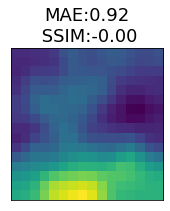

In [32]:
# 10 Seed

plt.figure(figsize=(10,23))

xInd=1

f_size=18

mod_true = np.reshape(output_2trans_test[xInd,:],[16,16]) # CHECK FOR TRAIN OR TEST

mod_pred_2trans = np.reshape(trans_2[:,xInd, loc_2trans2[0,xInd] ,0],[16,16]) # Shows most similar prediction
pred_mae = mean_absolute_error(mod_true, mod_pred_2trans)
pred_ssim = ssim(mod_true, mod_pred_2trans)
filter_pred = cv2.GaussianBlur(mod_pred_2trans,(3,3),0) # Gaussian smoothing
filter_mae = mean_absolute_error(mod_true, filter_pred)
filter_ssim = ssim(mod_true, filter_pred)

# plt.subplot(711)
# plt.imshow(mod_true)
# # Turn off tick labels
# plt.xticks([])
# plt.yticks([])
# # plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_mae:0.2f}',fontsize=f_size)

# # Original Prediction
plt.subplot(712)
plt.imshow(filter_pred)
# Turn off tick labels
plt.xticks([])
plt.yticks([])
plt.title(f'MAE:{filter_mae:0.2f}\n SSIM:{filter_ssim:0.2f}',fontsize=f_size)

# plt.subplots_adjust(hspace=0.4)